Ce calepin regroupe **diverses propositions d'analyse d'une image par ses couleurs**. L'inspiration principale sera les palettes publiées par le compte IG [*Color Palette Cinema*](https://www.instagram.com/colorpalette.cinema/) :

!["Les huit salopards cravatés"](https://i.pinimg.com/736x/1c/8b/ce/1c8bce00867dc058828b7584bbfe35e4.jpg)

L'objectif premier est de mettre un peu le nez sous le capot afin de proposer [notre propre variation](https://github.com/raphadasilva/devil_palette), davantage axée vers l'analyse.

Nous aborderons ce problème via :
* **des manipulations de tableaux Numpy**. Un des gros enjeux de ce travail est **de minimiser les temps de traitement**, et Numpy reste un atout majeur en la matière. Même si [l'implémentation d'Apache Arrow dans la dernière version de pandas](https://datapythonista.me/blog/pandas-20-and-the-arrow-revolution-part-i) va peut-être à terme bousculer ce postulat
* des **visualisations à trois dimensions**
* des **discrétisations assistées par apprentissage automatique** en général, et K-Means en particulier

Bref, un beau programme se profile, et nous allons démarrer par l'aspect visualisation. Les lauréats côté modules sont [Numpy](https://numpy.org/), [Maltplotlib](https://matplotlib.org/) et évidemment [Python Imaging Library](https://he-arc.github.io/livre-python/pillow/index.html) (PIL) :

In [1]:
import re, requests
import matplotlib.lines as mlines
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
from PIL import Image

# Observations en trois dimensions

Commençons par considérer une image, par exemple [une tirée d'une certaine série photo de mon cru](https://www.flickr.com/photos/raphipons/albums/72157719879546658).

Nous allons coder une fonction qui **convertit une [image en rouge-vert-bleu](https://fr.wikipedia.org/wiki/Rouge-vert-bleu) (RGB en anglais)**. Elle est précédée d'une fonction qui teste un chemin d'accès et modifie une éventuelle URL **en image prête à être traitée par PIL** :

In [2]:
def open_pic(path:str):
  """
    Cette fonction renvoie une image, si la chaîne de cara en paramètre pointe vers un fichier jpeg ou png valide.
    nb : marche aussi avec les URL
  """
  url_reg = r"^http[s]{,1}.*\.(([jJ][pP][Ee]{,1}[Gg])|([Pp][Nn][Gg]))$"
  file_reg = r".*\.(([jJ][pP][Ee]{,1}[Gg])|([Pp][Nn][Gg]))$"
  try:
    if re.match(url_reg,path):
      img = requests.get(path)
      return Image.open(BytesIO(img.content))
    elif re.match(file_reg,path):
      return Image.open(path)
    else:
      print("Merci de renseigner un chemin/URL pointant vers un fichier jpg ou png !")
  except requests.ConnectionError:
    print("Attention, l'URL renseignée ne semble pas pointer vers un serveur.")
  except PIL.UnidentifiedImageError:
    print("Attention, le chemin renseigné ne semble pas pointer vers un jpeg ou png valide !")


def rgb_convert(path:str):
    """
        Cette fonction convertit une image au format RGB.
    """
    try:
      return open_pic(path).convert('RGB')
    except:
        print("Quelque chose a coincé, peut-être à cause d'une corruption du fichier image.")

**Le résultat renvoie une classe Image,** comme on peut le vérifier par test :

In [3]:
mosa = rgb_convert("https://live.staticflickr.com/65535/52415681975_e72a706a2f_k.jpg")
print(type(mosa))

<class 'PIL.Image.Image'>


Nous pouvons donc l'afficher comme il se doit...

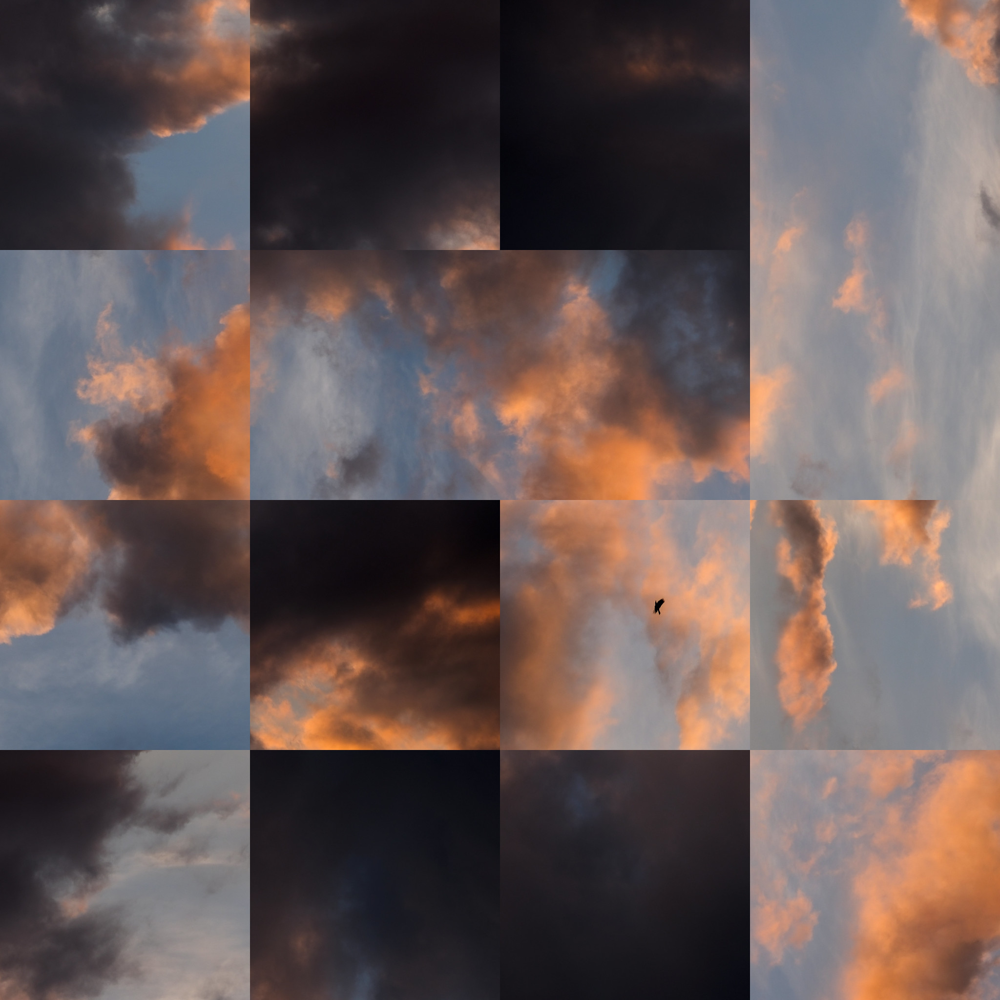

In [4]:
# normalement nous exécuterion un banal mosa.show(), mais sur Colab préférons...
mosa

...et utiliser les divers attributs de sa classe, comme la taille...

In [5]:
mosa.size

(2048, 2048)

...ou la composition du pixel central :

In [6]:
mosa.getpixel(tuple([int(l/2) for l in list(mosa.size)]))

(177, 121, 96)

Deux remarques, à ce stade :
* la couleur en question est un genre de marron
* l'intérêt d'avoir converti l'image en RGB réside dans le formatage **de tuples en triple**, chaque valeur de chaque triplet pouvant aller de 0 à 255

On peut très facilement ranger les tuples correspondant aux couleurs des presque 4,2 millions de pixels de cette image dans un tableau Numpy !

In [7]:
# on copie afin d'entériner les modifs à venir (la variable mosa est sinon en lecture seule)
colors = np.asarray(mosa.copy())

Voyons voir la tête de ce tableau :

In [8]:
colors

array([[[ 37,  32,  38],
        [ 37,  32,  38],
        [ 36,  31,  37],
        ...,
        [147, 105,  89],
        [141, 102,  87],
        [137, 100,  84]],

       [[ 37,  32,  38],
        [ 37,  32,  38],
        [ 36,  31,  37],
        ...,
        [141, 102,  85],
        [137,  98,  83],
        [134,  96,  83]],

       [[ 37,  32,  38],
        [ 37,  32,  38],
        [ 36,  31,  37],
        ...,
        [139, 100,  85],
        [135,  98,  82],
        [133,  95,  82]],

       ...,

       [[135,  97,  84],
        [134,  96,  83],
        [131,  95,  83],
        ...,
        [125, 115, 123],
        [125, 115, 123],
        [127, 117, 125]],

       [[135,  97,  84],
        [135,  97,  84],
        [132,  96,  82],
        ...,
        [125, 115, 123],
        [125, 115, 123],
        [124, 117, 124]],

       [[136,  99,  83],
        [135,  97,  84],
        [133,  97,  83],
        ...,
        [125, 115, 123],
        [125, 115, 123],
        [124, 117, 124]]

La facilité avec laquelle Numpy peut imbriquer des tableaux les uns dans les autres peut être déstabilisante. Nous allons afficher les dimensions du tableau colors via l'attribut shape :

In [9]:
colors.shape

(2048, 2048, 3)

Grâce à cette information, nous sommes en mesure d'utiliser **la puissante syntaxe de "tranchage" du modume** afin d'interroger les données.

Par exemple, si nous voulons rassembler la troisième valeur de chaque tableau dans la première et la deuxième dimension (ie les valeurs liées au canal bleu en longueur et en largeur) :

In [10]:
colors[:,:,2]

array([[ 38,  38,  37, ...,  89,  87,  84],
       [ 38,  38,  37, ...,  85,  83,  83],
       [ 38,  38,  37, ...,  85,  82,  82],
       ...,
       [ 84,  83,  83, ..., 123, 123, 125],
       [ 84,  84,  82, ..., 123, 123, 124],
       [ 83,  84,  83, ..., 123, 123, 124]], dtype=uint8)

C'est pas mal du tout, mais ce serait encore mieux d'avoir toutes ces valeurs dans un unique tableau. **Il s'agit de les "aplatir"** afin de ne plus avoir qu'une seule dimension. [La fonction flatten](https://numpy.org/doc/stable/reference/generated/numpy.ndarray.flatten.html) de Numpy est toute désignée pour cela :

In [11]:
colors[:,:,2].flatten()

array([ 38,  38,  37, ..., 123, 123, 124], dtype=uint8)

Isoler chaque canal de cette façon va nous permettre de visualiser l'ensemble de nos couleurs [**dans un nuage de points 3D**](https://matplotlib.org/stable/gallery/mplot3d/scatter3d.html). Pour cela, Matplotlib est toute désignée :

(*attention la manœuvre va prendre du temps en raison du volume de données !*)

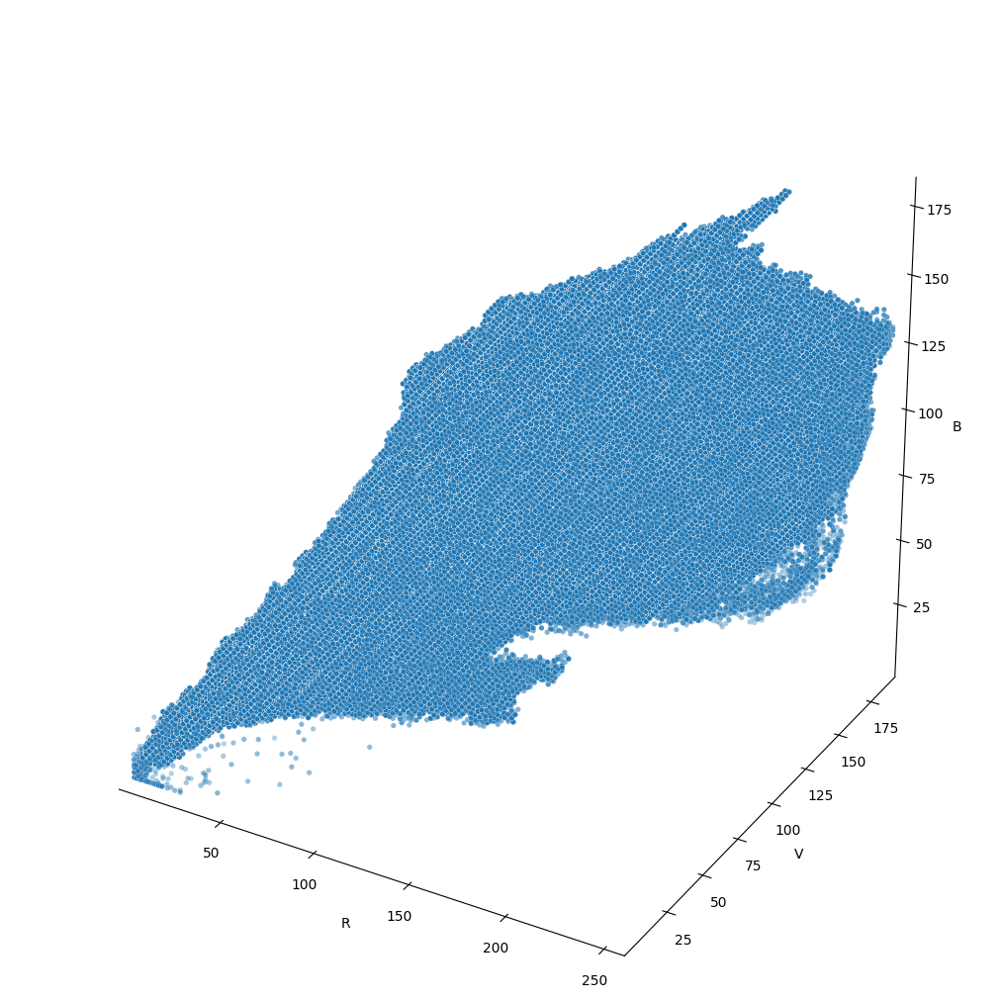

In [12]:
fig = plt.figure(figsize=(20,10),constrained_layout=True)
ax = fig.add_subplot(projection='3d', xmargin=0, ymargin=0, zmargin=0)
ax.set_aspect('equal')
ax.grid(False)

ax.scatter(colors[:,:,0].flatten(), colors[:,:,1].flatten(), colors[:,:,2].flatten(), marker="o", s=15, edgecolor="white",linewidth=.2)
ax.xaxis.pane.fill = False
ax.xaxis.pane.set_edgecolor('w')
ax.set_xlabel('R')
ax.set_xlim(.01)
ax.yaxis.pane.fill = False
ax.yaxis.pane.set_edgecolor('w')
ax.set_ylabel('V')
ax.set_ylim(.01)
ax.zaxis.pane.fill = False
ax.zaxis.pane.set_edgecolor('w')
ax.set_zlabel('B')
ax.set_zlim(.01)

plt.show()

Même si chaque pixel dans l'image a la même couleur, nous pouvons nous risquer à distinguer quelques groupes particuliers. Par exemple :
* le "coude" à l'origine
* deux excroissances sur les bords du graphe
* une espèce de ligne tout en haut

Le mieux pour poursuivre l'analyse serait **de colorier chaque point de cette tête de poulpe par sa couleur dans la photographie**. Nous allons pour cela coder une fonction de conversion.

Plusieurs solutions ont été envisagées, et voici un topo sur la plus rapide testée :
* dans le cas où nous partirions de l'image à peine convertie par Numpy, nous transposons le grand tableau Numpy afin d'avoir chaque couleur enregistrée dans un tableau. Ensuite, on encode chaque triplet en octets avant de le convertir en en hexadécimal
* dans le cas où nous partirions d'un cluster (patience), la manip est groso modo la même avec une conversion un peu plus coûteuse mais compensée par la taille réduite des données considérées

In [13]:
def hex_convert(arr:np.array, state="picture"):
  """
    Cette fonction convertit un array Numpy rempli de triplets R,G,B en codes hexadécimaux.
  """
  try:
    match(state):
      case "picture":
        transpo = np.dstack((arr[:,:,0].flatten(),arr[:,:,1].flatten(),arr[:,:,2].flatten()))[0,:,:]
        return [f"#{bytes(t).hex().upper()}" for t in transpo]
      case "clusters":
        return ['#%02X%02X%02X' % tuple(t) for t in arr]
      case _:
        print("Attention, seul deux cas sont paramétrés pour state : 'picture' pour un array non rangé")
  except TypeError:
    print("Attention au format de la variable : il faut un tableau Numpy content des triplets RGB valides tels que [0,255,0]")
  except IndexError:
    print("Attention à la taille de vos variables")

Elle va nous permettre de créer une nouvelle liste à partir de chaque tableau numpy (la couleur RGB d'un pixel) contenu dans colors. Cette dernière contiendra **les codes hexadécimaux codant chaque couleur**.

Démonstration :

In [14]:
col_plots = hex_convert(colors)
col_plots[:5]

['#252026', '#252026', '#241F25', '#241F25', '#241F25']

**Trois secondes, montre en main, qui suffisent à convertir les millions de pixels de l'image !** Tout cela semble bel et bon, et nous allons remettre à jour notre nuage précédent en coloriant chaque point par la couleur correspondante :

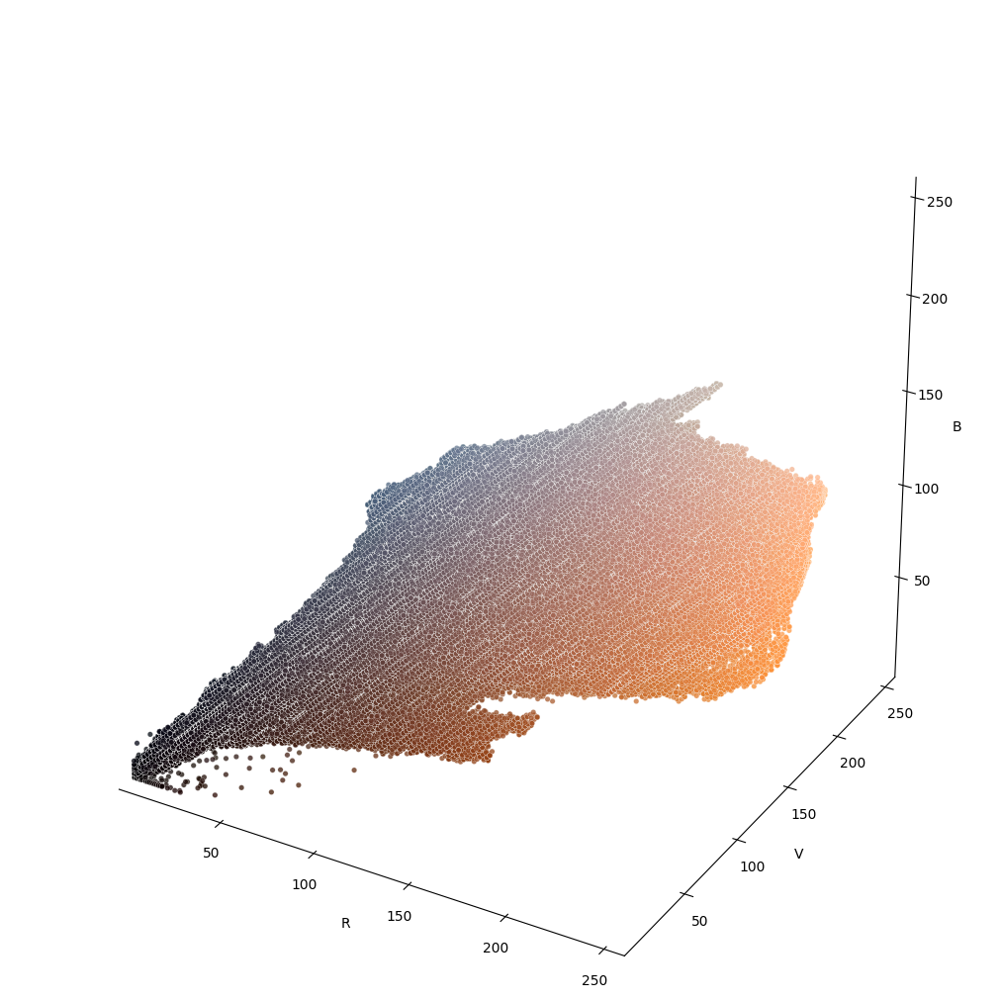

In [15]:
fig = plt.figure(figsize=(20,10),constrained_layout=True)
ax = fig.add_subplot(projection='3d',xmargin=0)
ax.set_aspect('equal')

ax.scatter(colors[:,:,0].flatten(), colors[:,:,1].flatten(), colors[:,:,2].flatten(), marker="o", c=col_plots, s=15, alpha=.75, edgecolor="white",linewidth=.2)
ax.grid(False)
ax.xaxis.pane.fill = False
ax.xaxis.pane.set_edgecolor('w')
ax.set_xlabel('R')
ax.set_xlim([.01,255])
ax.yaxis.pane.fill = False
ax.yaxis.pane.set_edgecolor('w')
ax.set_ylabel('V')
ax.set_ylim([.01,255])
ax.zaxis.pane.fill = False
ax.zaxis.pane.set_edgecolor('w')
ax.set_zlabel('B')
ax.set_zlim([.01,255])

plt.show()

**Certains agrégats distingués avant semblent bien correspondre à des groupes de couleurs approchantes**. Par exemple, le coude à l'origine correspond aux couleurs sombres (valeurs proches de 0 quel que soit le canal), ou l'excroissance orangée est groso modo cloisonnée entre 200 et 230 sur le canal rouge, 180 et 230 sur le canal vert et 0 et 75 sur le canal bleu.

Notons au passage que les nuances bleutées semblent cantonnées à l'arrière du graphe. Cela ne facilite pas la lecture et expose une des limites des visualisations en 3D.

D'ailleurs, quel est le nombre de couleurs dans cette image ? Réponse :

In [16]:
len(col_plots)

4194304

Preque 4,2 millions, ce qui est tout à fait conforme à un carré de 2048 x 2048 pixels. Pour rappel, l'ensemble des couleurs encodables en RGB égale 256 au cube, soit **presque 16,8 millions de couleurs uniques**.

Mais il y a des doublons dans notre photo, nous avons pu le constater dès les premières entrées du grand tableau Numpy. Pour les considérer, nous allons nous servir de deux nouveaux modules. Il y aura l'incontournable pandas, couteau suisse de la stat en Python et Seaborn en ce qui concerne la visualisation :

In [17]:
import pandas as pd
import seaborn as sns

Pandas va nous permettre de formater le tableau colors et la liste de codes hexadécimaux en base de données (BDD) tabulaires digne de nom.

**Il serait dommage de se priver de la moindre occasion de factoriser des commandes rébarbatives**, nous allons donc coder deux fonctions dédiées :

In [18]:
def empty_df(l_col:list):
    """
        Cette fonction renvoie une DataFrame vide dont les colonnes sont dictées par une liste choisie par l'utilisateur.
    """
    try:
        return pd.DataFrame(columns=l_col)
    except TypeError:
        print("Merci de bien mettre une liste en unique argument de cette fonction")

def col_neslist(DF:pd.core.frame.DataFrame,neslist:np.array,col:list):
    """
        Cette fonction crée ou met à jour les colonnes d'une DF en fonction d'arrays Numpy imbriqués interrogés par position.
        Ces derniers doivent tous avoir la même longueur, et cette longueur doit être égale à celle de la list col.
    """
    try:
        if len(neslist.shape) == 3:
            for i,k in enumerate(col):
                DF[k] = neslist[:,:,i].flatten()
        else:
            for i,k in enumerate(col):
                DF[k] = neslist[:,i]
        return DF
    except TypeError:
        print("Attention aux format des variables : DF = DataFrame / nestlist = arrays Numpy imbriqués / col = liste")
    except IndexError:
        print("Attention à la taille de la liste col : elle doit être de la même longueur que les tableaux imbriqués !")
    except ValueError:
        print("Attention aux tailles comparées : la DF a trop de lignes en comparaison des colonnes que vous essayez de mettre à jour")

Plus qu'à les tester en conditions réelles :

In [19]:
DF_col = empty_df(["r","v","b","hex"])
DF_col = col_neslist(DF_col,colors,["r","v","b"])
DF_col["hex"] = col_plots
DF_col.tail()

,r,v,b,hex
4194299,131,118,125,#83767D
4194300,129,118,126,#81767E
4194301,125,115,123,#7D737B
4194302,125,115,123,#7D737B
4194303,124,117,124,#7C757C


Devinez quoi ? Rien ne dépasse ! On peut désormais compter le nombre de codes hexadécimaux uniques rencontrés dans notre photo :

In [20]:
len(DF_col["hex"].unique())

48233

Ce qu'il y a de génial en Python, c'est de constater à quel point **différentes méthodes aussi intuitives les unes que les autres peuvent amener au même résultat**.

Cette non déplaisante de recoupement va s'illustrer directement depuis le tableau Numpy colors, en exploitant la principale propriété des sets Python (ils ne tolèrent pas de doublons) :

In [21]:
len(set([tuple(t) for t in col_plots]))

48233

48 233 couleurs uniques des deux côtés, soit à peine plus de 1% de l'ensemble des pixels présents sur la photo...

Nous pourrions tout miser sur les doublons, et compter les occurrences de chacune de ces couleurs. Objectif : **visualiser le Top 10 des couleurs les plus rencontrées afin de voir si une palette se distingue**.

Cela peut se faire rapidement en utilisant la bibliothèque de visualisation Seaborn couplée à la méthode value_counts() de pandas :

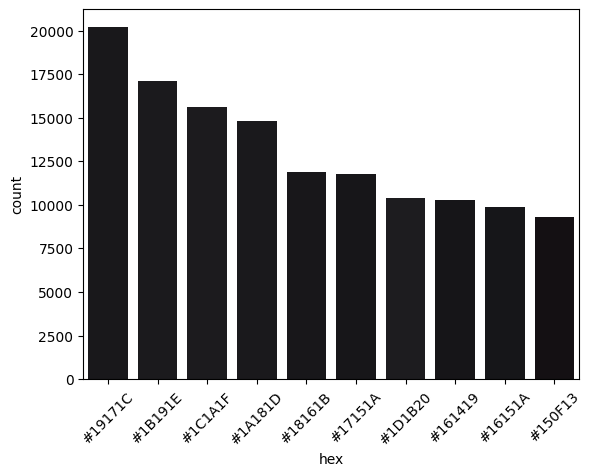

In [22]:
sns.countplot(data=DF_col, x="hex", order=DF_col["hex"].value_counts()[:10].index,palette=DF_col["hex"].value_counts()[:10].index)
plt.xticks(rotation=45);

Dix nuances de noirs, impossibles à distinger à l'œil nu. Chou blanc de ce côté-là. Est-on définitivement bloqué pour autant ? Pour le dire vite, pas forcément...

# Discrétisation assistée par moyennes non supervisées

## Premiers clusters avec l'algorithme K-Means

Ce que nous cherchons à faire ressembler à ce que **les géographes nomment [la discrétisation](https://geoconfluences.ens-lyon.fr/glossaire/discretisation#:~:text=Op%C3%A9ration%20de%20simplification%20de%20l,plages%20de%20valeurs%2C%20ou%20classes.)**.

Avec notre palette nous ne voulons pas rendre *discrètes* les différences entre données, mais tout de même constituer des groupes (une teinte "globale" par groupe) suivant deux règles complémentaires :
* à l'intérieur d'un groupe, il y a le moins de différences possible. Aucune teinte plutôt orangée n'a (dans l'idéal) du bleu dans son groupe
* entre les groupes, il y a le maximum de disensions (un bleu n'est jamais rangés parmi les orangés)

Du côté de l'analyse de données, on parlera de [partitionnement de données (ou *clustering*)](https://ocw.mit.edu/courses/6-0002-introduction-to-computational-thinking-and-data-science-fall-2016/). L'idée est de diviser un ensemble en différents sous-groupes cohérents **sans classification préalable servant de référence**. L'exercice est idéal pour **les algorithmes d'apprentissages non supervisés**.

Dans le cas des couleurs RGB ou hexadécimales, **un algorithme supervisé n'aurait aucun sens**, car on connaît déjà une relation mathématique reliant les composantes RGB avec une couleur donnée.

En revanche, un algo non supervisé peut permettre de trouver une relation de proximité évitant d'avoir à ranger 40 000 enregistrements dans des teintes type "orange", "bleu", "noir", etc...

Nous allons tester [l'algorithme K-Means](https://ocw.mit.edu/courses/6-0002-introduction-to-computational-thinking-and-data-science-fall-2016/), qui va **déterminer à partir d'un nombre abitraire de clusters leurs différents centres moyens dans l'espace à trois dimensions RVB**.

K-Mean est implémenté directement avec la bibliothèqe scikit-learn, et nous allons donc importer tout ce qui nous sera utile :

In [23]:
from sklearn.cluster import KMeans
from sklearn.metrics  import silhouette_score

Nous allons éprouver un algorithme non supervisé, **il est donc inutile de diviser l'ensemble des données entre un échantillon d'apprentissage et un échantillon de test**.

Les colonnes "r", "v" et "b" de la DataFrame référente serviront de terrain d'apprentissage unique :

In [24]:
# par convention, X correspond toujours aux données d'apprentissage
X = DF_col[["r","v","b"]]

Cette base d'apprentissage bien formatée, nous allons entraîner un modèle avec dix clusters afin de coller aux palettes du compte IG cité en introduction :

In [25]:
modele_test = KMeans(n_clusters=10,n_init=10).fit(X)

Une fois la bête nourrie, nous pouvons voir un peu les attributs du modèle :

In [26]:
dir(modele_test)

['__abstractmethods__',
 '__annotations__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__slots__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_abc_impl',
 '_algorithm',
 '_check_feature_names',
 '_check_mkl_vcomp',
 '_check_n_features',
 '_check_params_vs_input',
 '_check_test_data',
 '_estimator_type',
 '_get_param_names',
 '_get_tags',
 '_init_centroids',
 '_more_tags',
 '_n_features_out',
 '_n_init',
 '_n_threads',
 '_parameter_constraints',
 '_repr_html_',
 '_repr_html_inner',
 '_repr_mimebundle_',
 '_sklearn_auto_wrap_output_keys',
 '_tol',
 '_transform',
 '_validate_center_shape',
 '_validate_data',
 '_validate_params',
 '_warn_mkl_vcomp',
 'algorithm',
 'cluster_

Une caractéristique très intéressante pour nous se niche dans **les centres de ces clusters**. Nous allons donc les afficher :

In [27]:
modele_test.cluster_centers_

array([[147.06420396,  99.48310347,  79.18728381],
       [ 40.41805535,  34.18899682,  38.52489924],
       [162.45553873, 149.51753796, 147.21035531],
       [ 98.30033977,  77.00433689,  73.85392314],
       [132.93975142, 130.92758705, 136.88737563],
       [212.56102666, 151.13602088, 118.23592848],
       [ 65.88598954,  53.22875442,  55.1062595 ],
       [189.81206803, 121.86997917,  84.1242702 ],
       [ 21.47201531,  18.45572217,  23.55926402],
       [106.63354816, 113.35882682, 127.63668788]])

Les trois dimensions des canaux RGB ont bien été conservés, mais **il nous faut des nombres entiers** pour les colorer. Cela va se régler via une fonction :

In [28]:
def round_list(t:list):
  """
    Cette fonction retourne une liste de nombres entiers arrondis à partir d'une liste de nombres à décimales.
  """
  try:
    return [int(round(e)) for e in t]
  except:
    print("Attention : votre liste de base ne doit contenir que des nombres !")

Nous la testons illico :

In [29]:
cent_clus = np.array([round_list(l) for l in modele_test.cluster_centers_])
cent_clus

array([[147,  99,  79],
       [ 40,  34,  39],
       [162, 150, 147],
       [ 98,  77,  74],
       [133, 131, 137],
       [213, 151, 118],
       [ 66,  53,  55],
       [190, 122,  84],
       [ 21,  18,  24],
       [107, 113, 128]])

Nous allons ranger ces centres dans une DF spécialement dédiée (avec en plus une colonne de couleurs), en utilisant les fonctions précédentes :

In [30]:
def clusters_to_df(modele:KMeans):
  """
      Cette fonction transforme un modèle de clustering en DF contenant
         - des colonnes R, V, B,
         - une colonne des codes hexadécimaux correspondants
         - le code de cluster
  """
  try:
     centers = np.array([round_list(l) for l in modele.cluster_centers_])
     DF = empty_df(["r","v","b","hex"])
     DF["hex"] = hex_convert(centers,state="clusters")
     DF["cluster"] = DF.index
     DF = col_neslist(DF,centers,["r","v","b"])
     return DF
  except AttributeError:
    print("Attention à bien mettre en variable un modèle de clustering type K-Means")

Tout est prêt pour créer une nouvelle DF :

In [31]:
DF_clus = clusters_to_df(modele_test)
DF_clus

,r,v,b,hex,cluster
0,147,99,79,#93634F,0
1,40,34,39,#282227,1
2,162,150,147,#A29693,2
3,98,77,74,#624D4A,3
4,133,131,137,#858389,4
5,213,151,118,#D59776,5
6,66,53,55,#423537,6
7,190,122,84,#BE7A54,7
8,21,18,24,#151218,8
9,107,113,128,#6B7180,9


**Toute factorisation est bonne à prendre**, nous allons donc coder une fonction centrée sur la visualisation de clusters :

In [61]:
def D3_clusters(axis_ref,colors:pd.core.frame.DataFrame,clusters:pd.core.frame.DataFrame,r_data=3,r_cluster=150):
  """
      Cette fonction affiche un nuage de points 3D à partir d'une DF de couleurs d'une image
      et des centres de clusters associés (eux aussi transformés en DF)
  """
  try:
    axis_ref.set_aspect('equal')
    axis_ref.scatter(colors["r"], colors["v"], colors["b"], marker="o", c=colors["hex"], s=r_data, alpha=.4, edgecolor="white",linewidth=.002, zorder=1)
    axis_ref.scatter(clusters["r"], clusters["v"], clusters["b"], marker="o", c=clusters["hex"], s=r_cluster, alpha=.9, edgecolor="black",linewidth=.5, zorder=2)
    axis_ref.grid(False)
    axis_ref.xaxis.pane.fill = False
    axis_ref.xaxis.pane.set_edgecolor('w')
    axis_ref.set_xlabel('R')
    axis_ref.yaxis.pane.fill = False
    axis_ref.yaxis.pane.set_edgecolor('w')
    axis_ref.set_ylabel('V')
    axis_ref.zaxis.pane.fill = False
    axis_ref.zaxis.pane.set_edgecolor('w')
    axis_ref.set_zlabel('B')
  except:
    print("Attention au format de vos variables !")

Place maintenant à un nuage de points articulé autour des centres de clusters :

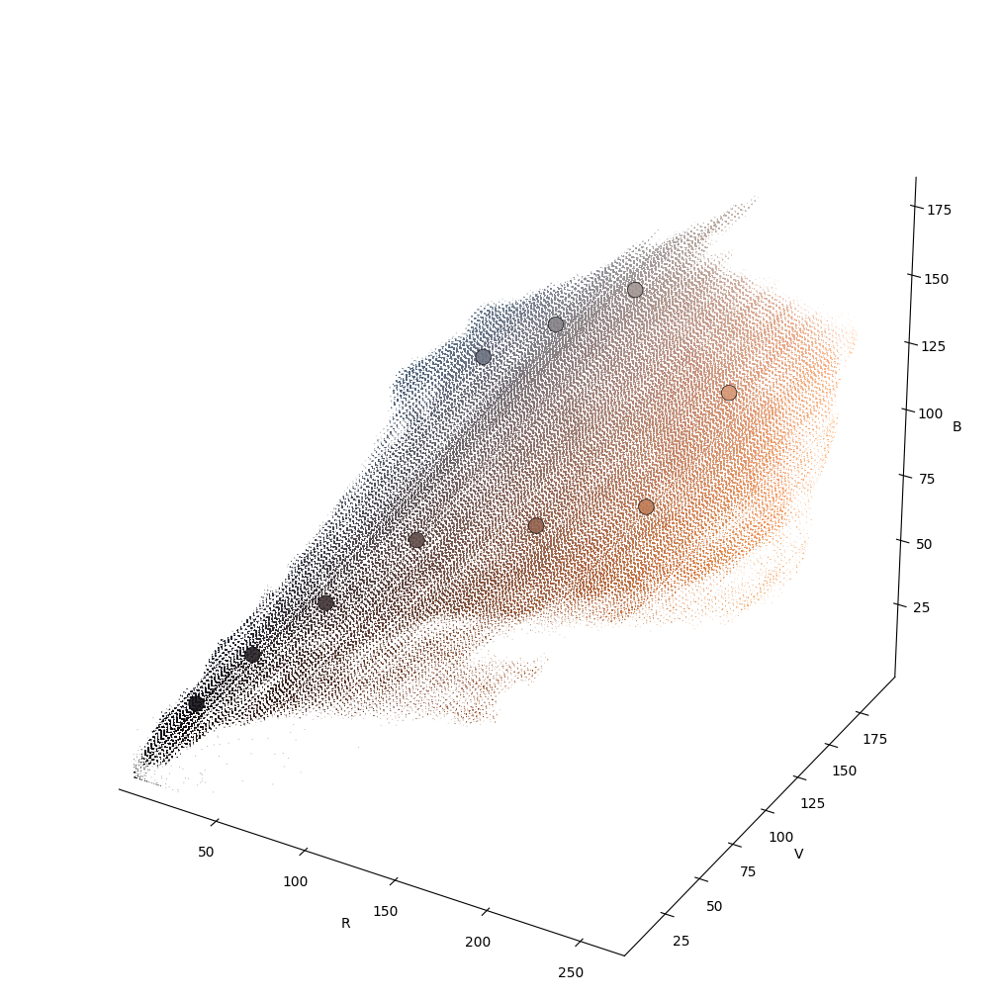

In [33]:
fig = plt.figure(figsize=(20,10),constrained_layout=True)
ax = fig.add_subplot(projection='3d',computed_zorder=False)
D3_clusters(ax,DF_col, DF_clus,r_data=.5,r_cluster=125)
ax.set_xlim(.01)
ax.set_ylim(.01)
ax.set_zlim(.01)
plt.show();

Cette affaire se présente pas mal du tout, avec une remarquable répartition des différents centres ! Quelques remarques à chaud :
* il y a **pas mal de centres périphériques**, notamment le triumvirat bleu-gris tout en haut du nuage et la triplette gris foncé-marron orangé juste en face. Avec un très large espace de couleurs sans aucun centre
* dix clusters pour la palette, c'est peut-être un poil trop. Cet écueil concernait d'ailleurs l'illustration de Color Palette Cinema, avec des teintes très approchantes. Automatiser **un nombre "idéal" situé entre deux et dix couleurs** serait un plus très enviable !

Plus simplement (et comme décidément cette visualisation met beaucoup de temps à se charger), nous pourrions nous demander si les choses seraient si différentes **en ne considérant que les couleurs uniques**

Pour cela, **une seule solution : la vérification**. Première étape, **la création d'une DF sans doublon aucun**. Cette dernière contiendra environ 50 000 valeurs en tout et pour tout, soit moins de pixels que le Top 3 des couleurs les plus rencontrées dans l'image de base.

Une belle simplification donc, assistée par une nouvelle fonction :

In [34]:
def unique_DF(DF:pd.core.frame.DataFrame,target:list,u_type="kfirst"):
    """
        Cette fonction renvoie une copie d'une DataFrame expurgés des doublons sur une colonne cible
    """
    UDF = DF.copy()
    try:
        match(u_type):
            case "kfirst":
                UDF = UDF.drop_duplicates(subset=target).reset_index(drop=True)
            case "sunique":
                UDF = UDF.drop_duplicates(subset=target,keep=False,ignore_index=True)
            case _:
                print("""Attention, seuls deux cas sont paramétrés pour u_type :
                    u_type='kfirst' pour garder toutes les valeurs apparaissant au moins une fois
                    u_type = 'sunique' pour ne garder que les valeurs qui n'apparaissent qu'une fois
                """)
    except TypeError:
        print("Merci de bien respecter les formats de variables attendues par la fonction")
    except KeyError:
        print("Merci de bien renseigner une liste de colonnes toutes présentes dans la DataFrame à écrémer !")
    return UDF

Il ne nous reste plus qu'à dérouler :

In [35]:
DF_ucol = unique_DF(DF_col,["hex"])
DF_ucol.tail()

,r,v,b,hex
48228,189,170,156,#BDAA9C
48229,99,68,65,#634441
48230,73,71,85,#494755
48231,70,80,92,#46505C
48232,243,148,90,#F3945A


Puis, entraînement d'un K-Means dédié, et récupération de ses centres :

In [36]:
X = DF_ucol[["r","v","b"]]
modele_u = KMeans(n_clusters=10,n_init=10).fit(X)
DF_uclus = clusters_to_df(modele_u)
DF_uclus

,r,v,b,hex,cluster
0,102,94,100,#665E64,0
1,187,132,106,#BB846A,1
2,136,122,123,#887A7B,2
3,229,161,121,#E5A179,3
4,33,25,27,#21191B,4
5,168,106,73,#A86A49,5
6,126,76,54,#7E4C36,6
7,178,152,143,#B2988F,7
8,223,136,78,#DF884E,8
9,77,57,54,#4D3936,9


Nous allons superposer les centres des clusters définis sur l'ensemble des points et ceux définis sur les couleurs uniques :

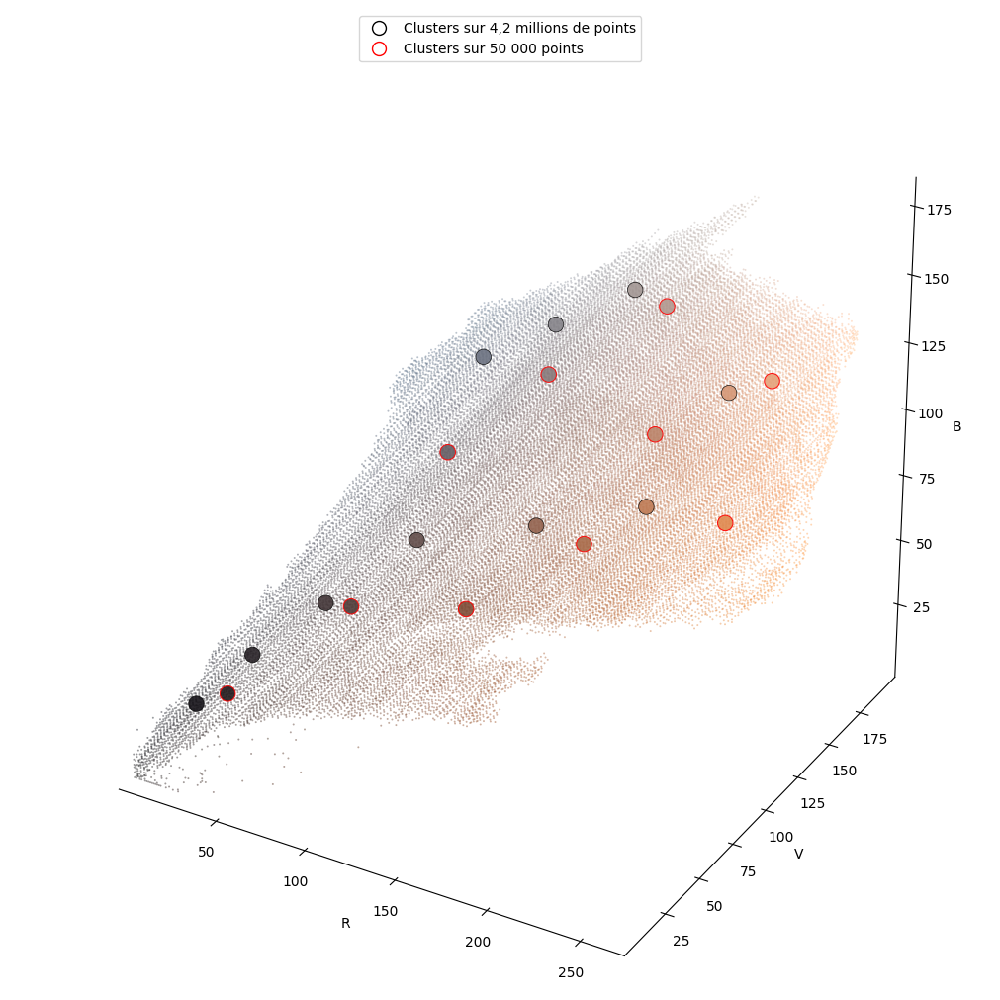

In [37]:
fig = plt.figure(figsize=(20,10),constrained_layout=True)
ax = fig.add_subplot(projection='3d',computed_zorder=False)

D3_clusters(ax,DF_ucol, DF_clus,r_data=2)
ax.scatter(DF_uclus["r"], DF_uclus["v"], DF_uclus["b"], marker="o", c=DF_uclus["hex"], s=125, alpha=.9, edgecolor="red",linewidth=.75, zorder=3)
ax.set_xlim(.01)
ax.set_ylim(.01)
ax.set_zlim(.01)

big_clus = mlines.Line2D([], [], markeredgecolor='black', color="white", marker='o', linewidth=.9, markersize=10, label='Clusters sur 4,2 millions de points')
little_clus = mlines.Line2D([], [], markeredgecolor='red', color="white", marker='o', linewidth=.9, markersize=10, label='Clusters sur 50 000 points')
plt.legend(handles=[big_clus,little_clus], loc="upper center")

plt.show()

Nous constatons **un remarquable déplacement des centres**, notamment ceux des teintes bleues ou grises. De manière simpliste, nous pourrions affirmer que les des couleurs semblent mieux quadrillées avec des clusters de couleurs uniques, **car il y a moins de centre périphériques**. Le K-Means a grosso modo **le même écueil que la moyenne en statistique descriptive**, car il est sensible aux valeurs extrême. Dans notre cas, ce sont plutôt les nombreux doublons qui ont influencé les premiers barycentres.

Côté clusters, les choses sont renseignées de manière on ne peut plus basique, comme on peut le vérifier ci-après :



In [38]:
set(list(modele_u.labels_))

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9}

Et cerise sur le gâteau : ces identifiants chiffrés peuvent augmenter les données initiales. Nous allons créer une nouvelle colonne dans la DF de couleurs uniques, avec le cluster de référence. Ce qui motive bien une nouvelle fonction :

In [39]:
def labels_kmeans(DF:pd.core.frame.DataFrame,modele:KMeans):
  """
      Cette fonction labellise une DF qui a servi d'apprentissage à un modèle KMeans par le biais d'une nouvelle colonne.
  """
  try:
    DF = DF.copy()
    DF["cluster"] = modele.labels_
    return DF
  except IndexError:
    print("Attention à la DataFrame d'apprentissage, elle n'est pas de la taille attendue par le modèle.")

Il ne reste plus qu'à la tester :

In [40]:
DF_ucol = labels_kmeans(DF_ucol,modele_u)
DF_ucol

,r,v,b,hex,cluster
0,37,32,38,#252026,4
1,36,31,37,#241F25,4
2,38,33,39,#262127,4
3,39,34,40,#272228,4
4,34,32,37,#222025,4
...,...,...,...,...,...
48228,189,170,156,#BDAA9C,7
48229,99,68,65,#634441,9
48230,73,71,85,#494755,9
48231,70,80,92,#46505C,0


A titre de comparaison, nous allons compter les effectifs des clusters sur ces points uniques...

In [41]:
DF_ucol["cluster"].value_counts()

cluster
2    6529
5    5496
0    5477
7    5206
1    5143
3    5003
9    4437
8    4373
6    4250
4    2319
Name: count, dtype: int64

...et les comparer aux clusters sur la totalité des pixels :

In [42]:
DF_col = labels_kmeans(DF_col,modele_test)
DF_col["cluster"].value_counts()

cluster
8    735616
4    641899
2    548853
1    523430
9    416765
6    356026
3    302968
0    245991
5    216905
7    205851
Name: count, dtype: int64

Et plus concrètement ? Plus concrètement, nous allons **visualiser côte à côte les clusters contenant le point central**, côté ensemble des pixels et couleurs uniques :

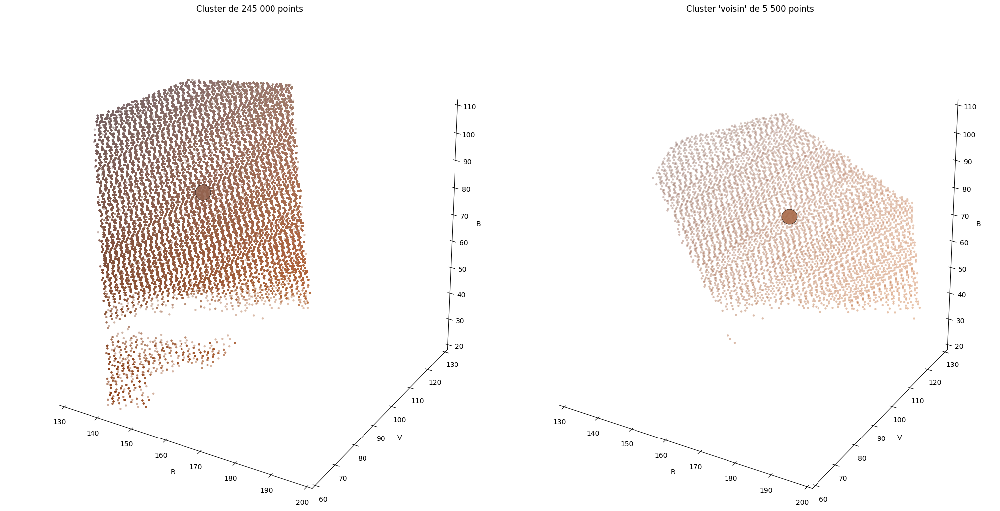

In [44]:
fig = plt.figure(figsize=(20, 12),constrained_layout=True)

ax1 = fig.add_subplot(121, projection='3d',computed_zorder=False)
D3_clusters(ax1,DF_col[DF_col["cluster"]==0], DF_clus[DF_clus["cluster"]==0],r_data=10,r_cluster=500)
ax1.set_title("Cluster de 245 000 points")
ax1.set_xlim([130,200])
ax1.set_ylim([60,130])
ax1.set_zlim([20,110])


ax2 = fig.add_subplot(122, projection='3d',computed_zorder=False)
D3_clusters(ax2,DF_ucol[DF_ucol["cluster"]==5], DF_uclus[DF_uclus["cluster"]==5],r_data=10,r_cluster=500)
ax2.set_title("Cluster 'voisin' de 5 500 points")
ax2.set_xlim([130,200])
ax2.set_ylim([60,130])
ax2.set_zlim([20,110])

plt.show()

Nous constatons **un prévisible glissement** du cluster initial d'environ 250 000 points marrons par rapport à son homologue des couleurs uniques, composé de 5 477 points.

Un point intéressant à relever : **ce dernier cluster est le deuxième plus fourni de l'ensemble des couleurs uniques**, tandis que son 'voisin' ne se hissait qu'en huitième position pour l'ensemble des pixels de l'image. Voici un effet remarquable de la purge des doublons dans les données d'apprentissage.

D'un point de vue pragmatique, **la focalisation sur les couleurs uniques a bien eu une incidence sur les calculs des centres**, mais aussi sur la vitesse d'exécution. A la louche, nous avons environ 35 secondes pour l'entraînement à 4 millions de points contre deux petites secondes pour le modèle à 40 000.

Nous pourrions discuter de la meilleure méthode, car **l'analyse de données implique de chercher un compromis le plus satisfaisant possible selon un objectif donné**. Certains considéreront par exemple que **retrancher une part si importante des pixels biaise l'analyse**, tandis que d'autres soutiendront **qu'en ne gardant que les couleurs uniques on se concentre sur la quintessence de l'image**.

Dans notre cas, les centres sont toujours cohérents (une palette diverse qui rend bien compte des teintes "clé" de l'images) et le temps de traitement sans aucune mesure avec ce qui a été observé précédemment.

L'objet de cette partie de calepin étant la meilleure optimisation à portée pour le commun des mortels, nous pourrions tester **[d'autres méthodes de clustering](https://scikit-learn.org/stable/auto_examples/cluster/plot_cluster_comparison.html#sphx-glr-auto-examples-cluster-plot-cluster-comparison-py)**.

Les alternatives testées (K-Medoids, Clustering spectral) s'étant révélées extrêmement gourmandes en mémoire vive, nous pencherons au final sur **un modèle de K-Means qui ne considérera que les couleurs uniques**. Mais il nous reste à considérer encore une autre question importante.

# Que pourrait être le nombre idéal de couleurs d'une palette ?

Dix couleurs pour une palette résumant l'image chargée en début de calepin est un chiffre sans doute trop élevé. En élaguant à la hussarde, nous pourrions retrancher deux couleurs du trio bleu-gris,une couleur du côté des orangés, et entre deux et trois couleurs pour les teintes les plus sombres.

**Soit une palette "optimale" comprise entre quatre et cinq couleurs**. Tout ça est bel et bon, mais pourrait-on trouver une mesure qui orienterait un nombre optimal de teintes dans n'importe quelle image ?

Cette limite du K-Means (nous connaissons rarement à l'avance le nombre de clusters avec lequel l'algorithme va ou doit le mieux fonctionner) peut être contournée de diverses manières.

Une solution bête et méchante va consister à tester le comportement d'un indicateur sur différentes tailles de clusters et à déterminer à partir de quel chiffre **ses performances commencent à diminuer de façon significative**. 

Le premier indacteur qui va nous préoccuper s'appelle **inertie, ou variance intracluster**. C'est cette dernière que l'algorithme va chercher à minimiser, quelle que soit le nombre de clusters retenue. Cette intertie va donc diminuer de façon mécanique en augmentant le nombre de classes, mais on peut parfois **observer *un coude* de rupture** marquant un nombre optimal de clusters.

Le second indicateur est **le score de silhouette**. Ce dernier va comparer les points à l'intérieur de chaque cluster avec les homologues des voisins, et déterminer un score situé entre -1 (grosse dissimilarité des points avec leur cluster assigné) et 1 (similarité parfaite).

In [45]:
mapping_inertie = {}
mapping_silhouette = {}

for i in range(2,11):
  print(f"Itération n°{i-1}")
  kmeanModel = KMeans(n_clusters=i,n_init=10).fit(X)
  kmeanModel.fit(X)
  mapping_inertie[i] = kmeanModel.inertia_
  mapping_silhouette[i] = silhouette_score(X, kmeanModel.labels_)

Itération n°1
Itération n°2
Itération n°3
Itération n°4
Itération n°5
Itération n°6
Itération n°7
Itération n°8
Itération n°9


Premier constat : le score de silhouette est long, très long, à calculer. Une fois ce gros morceau effectué, nous sommes en mesure de visualiser côte à côte les deux indiscateurs :

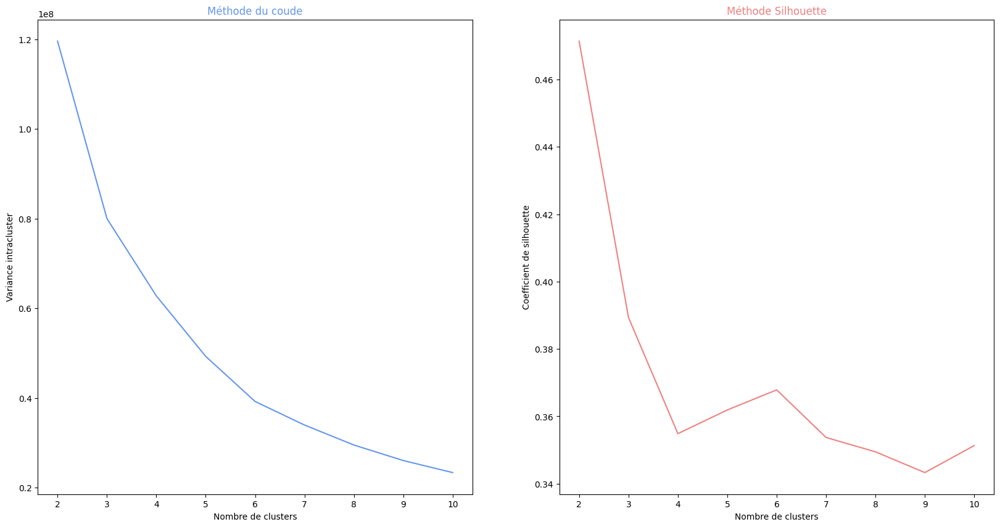

In [46]:
fig, axes= plt.subplots(1,2,figsize=(20,10))

ax1 = sns.lineplot(ax=axes[0], x=mapping_inertie.keys(), y=mapping_inertie.values(), color="cornflowerblue")
ax1.set_title("Méthode du coude", color="cornflowerblue")
ax1.set_xlabel("Nombre de clusters")
ax1.set_ylabel("Variance intracluster")

ax2 = sns.lineplot(ax=axes[1], x=mapping_silhouette.keys(), y=mapping_silhouette.values(), color="lightcoral")
ax2.set_title("Méthode Silhouette", color="lightcoral")
ax2.set_xlabel("Nombre de clusters")
ax2.set_ylabel("Coefficient de silhouette");

Nous avons l'illustration du problème récurrent avec ce type de méthode : 
* **le coude ne saute pas aux yeux** côté inertie
* le nombre de palettes optimal pour le score de silhouette (ie le nombre le plus élevé) correspond **à une palette extrêmement réduite de seulement deux couleurs** au regard de l'image de base. 

Plutôt que de multiplier les comparaisons d'indicateurs (nous pourrions par exemple nous pencher sur le [trou statistique](https://hastie.su.domains/Papers/gap.pdf)), nous allons préférer partir d'une transformation des données d'apprentissage.

Voici une hypothèse : même en purgeant les doublons, **les données conservent une trop grande continuité** qui parasite le calcul d'un nombre idéal de clusters. Nous allons : 
* tailler au forceps en ne conservant que les couleurs qui ne sont **jamais** doublonnés
* calculer le nombre de clusters (préférence pour l'inertie en raison de la rapidité d'exécution) idéal
* dresser les clusters définitifs en reprenant la DF intermédiaire sans les doublons

Magie de la factorisation, cette DF va être créée en un instant :

In [46]:
DF_ufcol = unique_DF(DF_col,["hex"],u_type="sunique")
DF_ufcol.tail()

,r,v,b,hex,cluster
5152,121,106,101,#796A65,9
5153,189,170,156,#BDAA9C,2
5154,99,68,65,#634441,3
5155,70,80,92,#46505C,3
5156,243,148,90,#F3945A,5


Une banale visualisation 3D suffit à mesurer l'archipellisation des données :

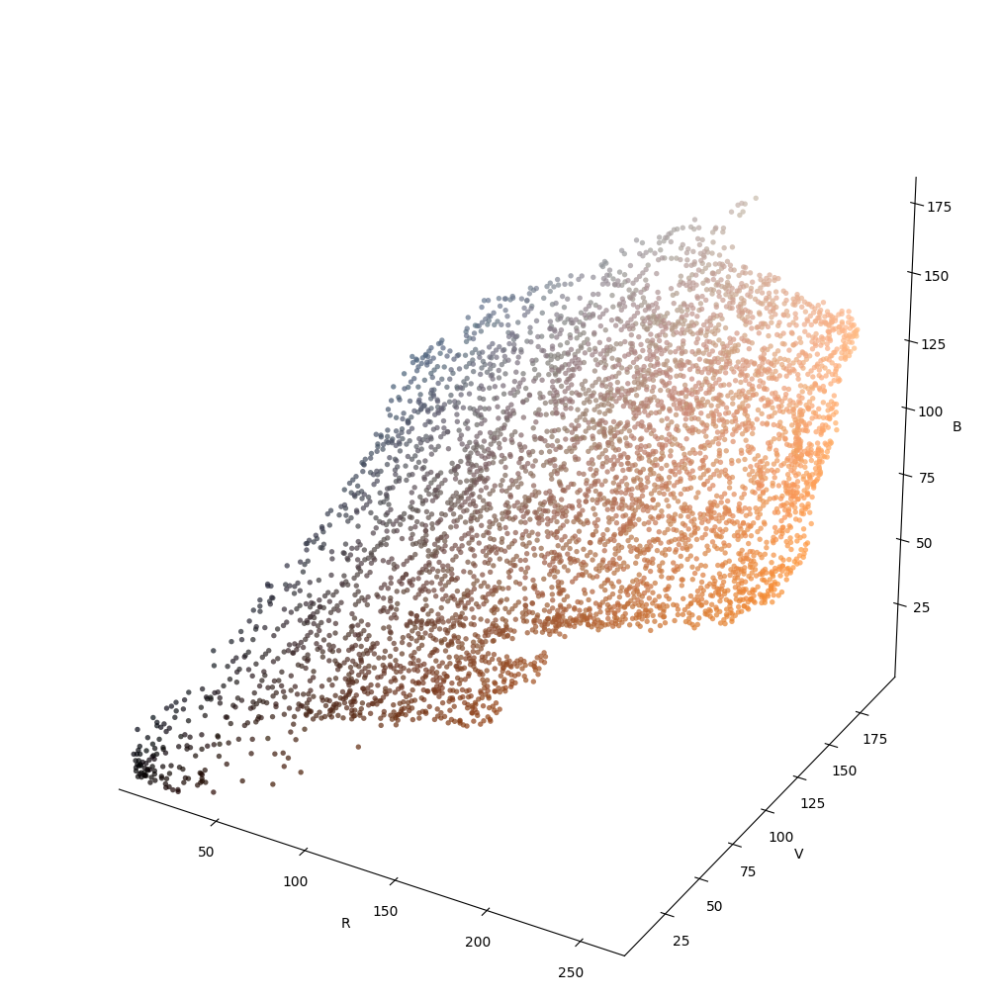

In [47]:
fig = plt.figure(figsize=(20,10),constrained_layout=True)
ax = fig.add_subplot(projection='3d')
ax.set_aspect('equal')

ax.scatter(DF_ufcol["r"], DF_ufcol["v"], DF_ufcol["b"], marker="o", c=DF_ufcol["hex"], s=15, alpha=.7, edgecolor="white",linewidth=.002, zorder=1)
ax.grid(False)
ax.xaxis.pane.fill = False
ax.xaxis.pane.set_edgecolor('w')
ax.set_xlabel('R')
ax.set_xlim(.01)
ax.yaxis.pane.fill = False
ax.yaxis.pane.set_edgecolor('w')
ax.set_ylabel('V')
ax.set_ylim(.01)
ax.zaxis.pane.fill = False
ax.zaxis.pane.set_edgecolor('w')
ax.set_zlabel('B')
ax.set_zlim(.01)

plt.show()

Nous allons importer un nouveau module, [Yellowbrick](https://www.scikit-yb.org/en/latest/) :

In [48]:
from yellowbrick.cluster import KElbowVisualizer

Ce catalogue de visualisations axées sur l'intelligence artificielle va augmenter les esquisses réalisées précédemment. Partons sur un nouveau jeu d'apprentissage centré sur les couleurs strictement uniques :

In [49]:
X = DF_ufcol[["r","v","b"]]

Et enchaînons sur une étude de cas, d'abord avec la méthode du coude d'inertie :

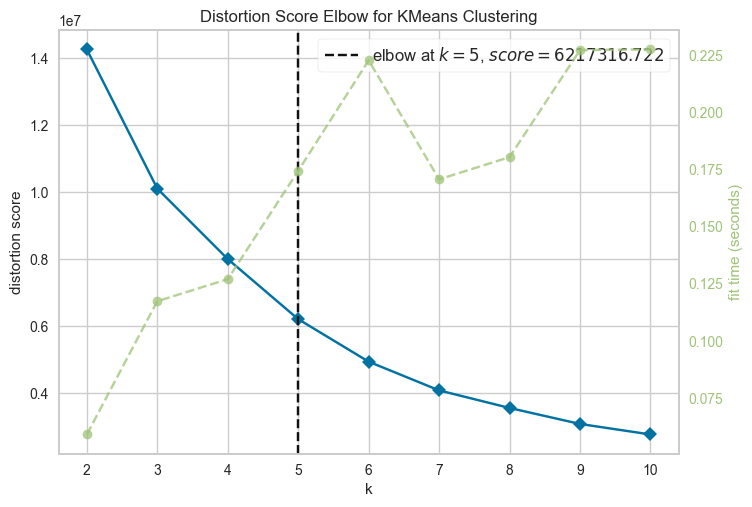

In [50]:
vis_elbow = KElbowVisualizer(KMeans(n_init=10), k=(2,11))

vis_elbow.fit(X)
vis_elbow.show();

Ensuite, avec le score de silhouette :

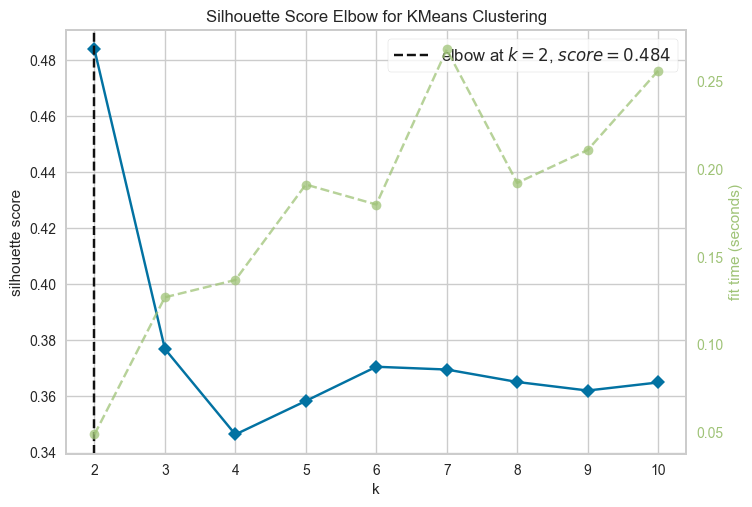

In [51]:
vis_silhouette = KElbowVisualizer(KMeans(n_init=10), k=(2,11), metric="silhouette")

vis_silhouette.fit(X)
vis_silhouette.show();

Toujours plus chronophage, toujours très réducteur, tout comme un autre indacteur de référence (Calinski-Harabasz). **Nous allons définitivement pencher vers l'inertie** en indicateur privilégié. Une fois la visu générée, on peut récupérer la valeur de coude retenue :

In [52]:
vis_elbow.elbow_value_

5

Cela mérite bien une nouvelle fonction :

In [135]:
def nclusters_kmeans(X:pd.core.frame.DataFrame):
  """
    Cette fonction renvoie un nombre "optimal" de clusters pour un algo K-Means. Ce nombre est déterminé en utilisant un "coude"
    retenu par le module yellowbrick.
  """
  print("Ca va prendre moins d'une minute, mais buvez du café !")
  try:
    draft = KElbowVisualizer(KMeans(n_init=10), k=(2,11))
    draft.fit(X)
    return draft.elbow_value_
  except:
    print("Attention au format attendu pour X : il s'agit bien d'une DF avec des Series chiffrées uniquement")

Ce chiffre de cinq clusters désormais confirmé, nous recalculons un K-Mean sur la DF intermédiaire :

In [136]:
X = DF_ucol[["r","v","b"]]
modele_u = KMeans(n_clusters=5,n_init=10).fit(X)

Et nous créons la DF de clusters associée ;

In [55]:
DF_uclus = clusters_to_df(modele_u)
DF_uclus

,r,v,b,hex,cluster
0,187,117,77,#BB754D,0
1,55,40,39,#372827,1
2,215,154,119,#D79A77,2
3,144,127,125,#907F7D,3
4,112,83,75,#70534B,4


Plus qu'à visualiser l'ensemble :

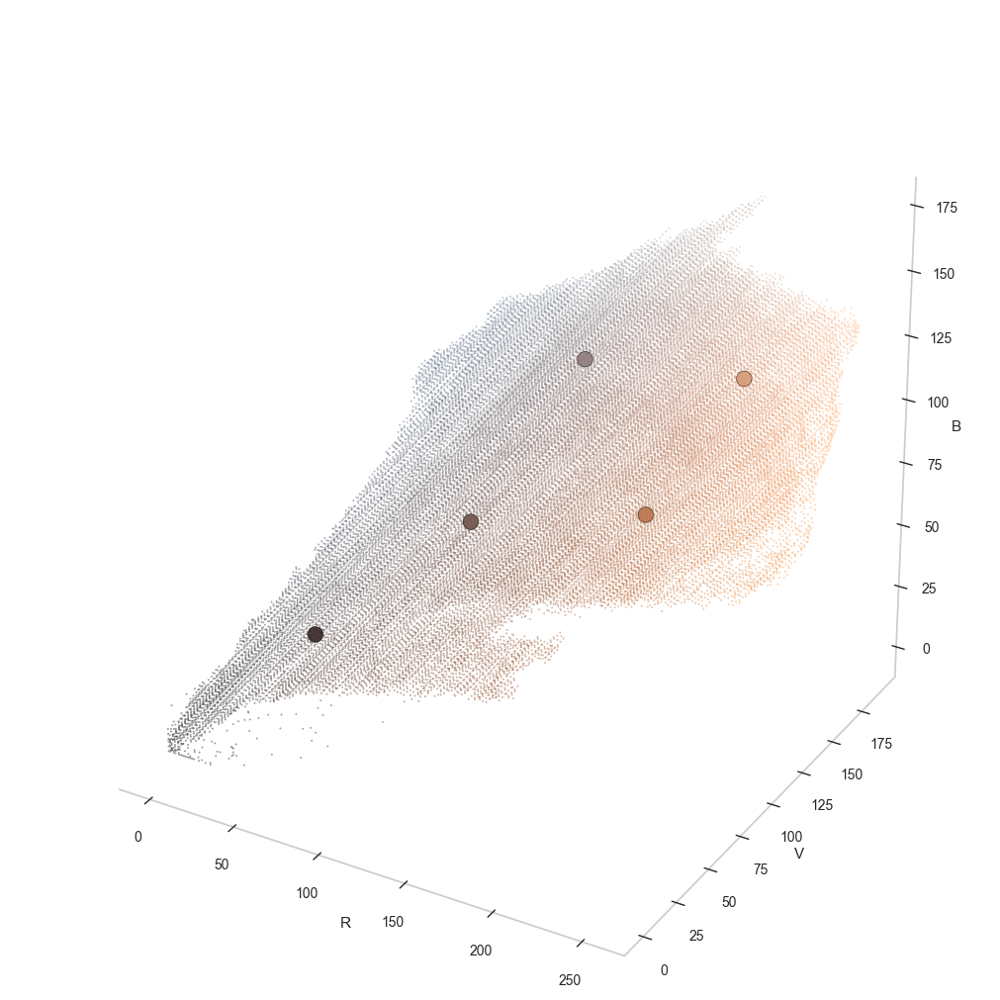

In [56]:
fig = plt.figure(figsize=(20,10),constrained_layout=True)
ax = fig.add_subplot(projection='3d')
D3_clusters(ax,DF_ucol,DF_uclus,r_data=2)
plt.show()

Cette sélection de couleur est plutôt satisfaisante, y compris en comparaison de services bien établis comme Google Palette :

![g_palette](img/g_palette.png "Title")

Mais nous avons encore quelques axes d'amélioration à explorer.

# 1, 3, 2 puzzles

Les palettes représentées par Color Palette Cinema ou Google Arts & Culture sont en tout point équitables : chaque couleur dispose de la même longueur que ses homologues. Or, **une palette proportionnelle** apporterait une intéressante information complémentaire.

Afin de l'illustrer, créons une nouvelle DF à partir des clusters définis précédemment :

In [57]:
clusters_def = labels_kmeans(DF_ucol, modele_u)
clusters_def

,r,v,b,hex,cluster
0,37,32,38,#252026,1
1,36,31,37,#241F25,1
2,38,33,39,#262127,1
3,39,34,40,#272228,1
4,34,32,37,#222025,1
...,...,...,...,...,...
48228,189,170,156,#BDAA9C,2
48229,99,68,65,#634441,4
48230,73,71,85,#494755,4
48231,70,80,92,#46505C,4


Pour rappel, les couleurs présentes dans cette DF sont bien présentes dans la DF de base, **puisque nous avons juste purgé les doublons**.

Nous pouvons donc fusionner la DF clusters_def avec l'initiale DF_col afin d'avoir une palette élargie à l'ensemble de l'image :

In [58]:
DF_col = DF_col[["r","v","b","hex"]]
merge_DF = clusters_def[["hex","cluster"]]
DF_col = DF_col.merge(merge_DF,on="hex")
DF_col

,r,v,b,hex,cluster
0,37,32,38,#252026,1
1,37,32,38,#252026,1
2,37,32,38,#252026,1
3,37,32,38,#252026,1
4,37,32,38,#252026,1
...,...,...,...,...,...
4194299,99,68,65,#634441,4
4194300,73,71,85,#494755,4
4194301,73,71,85,#494755,4
4194302,70,80,92,#46505C,4


Avant de passer à la partie visualisation, nous préparons une nouvelle fonction qui va calculer le pourcentage de chaque cluster :

In [206]:
def hexcent_clus(DF_dest:pd.core.frame.DataFrame,DF_source:pd.core.frame.DataFrame):
    """
      Cette fonction transforme une DataFrame contenant des clusters liés à des couleurs hexadécimales en pourcentages à partir de la DF d'apprentissage
    """
    try:
        DF_hexcent = DF_dest.copy()
        DF_hexcent = DF_hexcent[["hex","cluster"]]
        DF_hexcent["p"] = [round((len(DF_source[DF_source["cluster"]==c])/len(DF_source))*100,2) for c in DF_hexcent["cluster"]]
        DF_hexcent.sort_values(by=["p"], ascending=False, inplace=True)
        return DF_hexcent
    except IndexError:
        print("Attention, votre DF de clusters doit bien contenir deux colonnes hex et clusters.")

Nouvelle fonction implique ici nouvelle DF :

In [60]:
u_hexcent = hexcent_clus(DF_uclus,DF_col)
u_hexcent

,hex,cluster,p
1,#372827,1,37.69
3,#907F7D,3,36.06
4,#70534B,4,12.33
2,#D79A77,2,7.58
0,#BB754D,0,6.35


Passons de suite au versant visualisation de ce type de DF. Nous nous accorderons une petite coquetterie de développement, avec deux cas de figure d'orientation (horizontale et verticale). Cela peut toujours servir !

In [207]:
def bar_pct(axis_ref,DF:pd.core.frame.DataFrame,orientation="horizontal"):
    """
        Cette fonction affiche une palette en diagramme proportionnel trié dans l'ordre décroissant.
        NB : il est conseillé de l'utiliser après un appel de hexcent_clus()
    """
    try:
        match(orientation):
            case "horizontal":
                axis_ref.set_xlim(0,100)
                plt.barh(0,DF.iloc[0]["p"],color=DF.iloc[0]["hex"])
                counter = DF.iloc[0]["p"].copy()
                for c,p in zip(DF.iloc[1:]["hex"],DF.iloc[1:]["p"]):
                    plt.barh(0,p,color=c,left=counter)
                    counter += p
                axis_ref.grid(False)
                axis_ref.axis('off')
            case "vertical":
                axis_ref.set_xlim(0,100)
                plt.bar(0,DF.iloc[0]["p"],color=DF.iloc[0]["hex"])
                counter = DF.iloc[0]["p"].copy()
                for c,p in zip(DF.iloc[1:]["hex"],DF.iloc[1:]["p"]):
                    plt.barh(0,p,color=c,bottom=counter)
                    counter += p
                axis_ref.grid(False)
                axis_ref.axis('off')
            case _:
                print("Attention, seul deux cas sont codés pour l'attribut orientation. Veuillez choisir entre horizontal et vertical")
    except IndexError:
        print("Soyez vigilants sur la DataFrame : elle doit bien contenir des colonnes 'hex' et 'p'")

Place maintenant au cas qui nous préoccupe :

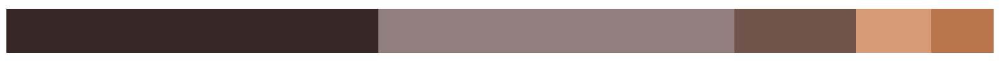

In [63]:
fig, ax = plt.subplots(figsize=(20,1))
bar_pct(ax,u_hexcent)
plt.show();

En un coup d'oeil, on constate que les deux premières couleurs de la palette occupent à elles seules les trois quarts de l'image. En parlant d'image... Si nous partons sur une visualisation en poster, **il est très superficiel de conserver une image trop lourde**.

Il serait même plus malin de charger une image allégée dont la moindre qualité ne se verra de toute façon pas. L'appel de la factorisation est là encore une fois le plus fort :

In [214]:
def pic_newd(img:Image,width=512):
    """
      Cette fonction renvoie la version réduite d'une image en conservant le ratio largeur/hauteur.
      IMPORTANT : le premier paramètre doit bien correspondre à la nouvelle largeur en pixels, pas à la hauteur.
    """
    try:
        ratio = img.size[0]/img.size[1]
        return img.copy().resize((width,int(round(width/ratio))))
    except TypeError:
        print("""Attention aux formats de vos variables. Pour rappel :
              width doit être un nombre
              img doit correspondre à une image digérée par le module PIL""")

Plus qu'à tester :

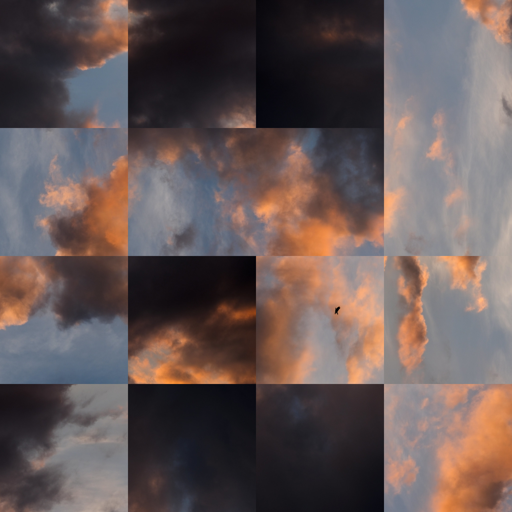

In [70]:
red_img = pic_newd(mosa)
red_img

Parfait, nous allons gagner du temps sur les étapes précédentes en mettant en fonction la création d'une tableau Numpy calé sur les pixels de l'image :

In [71]:
def pic_matrix(img:Image):
    """
        Cette fonction renvoie une matrice Numpy à partir d'une image RGB taillée pour être transformée en tableaux Numpy.
    """
    m_array = []
    try:
        m_array = np.asarray(img).copy()
    except PIL.UnidentifiedImageError:
        print("Attention, le chemin renseigné ne semble pas pointer vers un jpeg ou png valide !")
    return m_array

Nous partons ensuite sur une nouvelle DF, listant toutes les couleurs de l'image réduite :

In [72]:
red_col = col_neslist(pd.DataFrame(columns=["r","v","b","hex"]),pic_matrix(red_img),["r","v","b"])
red_col["hex"] = hex_convert(pic_matrix(red_img))
red_col

,r,v,b,hex
0,36,31,37,#241F25
1,36,31,37,#241F25
2,36,31,37,#241F25
3,37,32,38,#252026
4,37,32,38,#252026
...,...,...,...,...
262139,142,120,123,#8E787B
262140,135,117,120,#877578
262141,137,120,123,#89787B
262142,133,118,124,#85767C


Il est très tentant **de refaire une fusion avec les clusters calculés sur les couleurs uniques de la grande image**, et nous allons donc suivre cette voie :

In [73]:
red_col = red_col.merge(merge_DF,on="hex")
red_col

,r,v,b,hex,cluster
0,36,31,37,#241F25,1
1,36,31,37,#241F25,1
2,36,31,37,#241F25,1
3,36,31,37,#241F25,1
4,36,31,37,#241F25,1
...,...,...,...,...,...
154692,212,125,71,#D47D47,0
154693,201,121,70,#C97946,0
154694,139,91,71,#8B5B47,4
154695,151,118,111,#97766F,3


Plus qu'à visualiser la DF de pourcents après l'avoir créée :

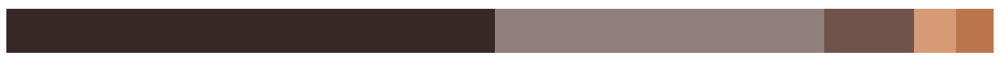

In [74]:
u_hextend = hexcent_clus(DF_uclus,red_col)
fig, ax = plt.subplots(figsize=(20,1))
bar_pct(ax,u_hextend)
plt.show();

Les effectifs ont pas mal bougé, alors qu'on aurait pu s'attendre à une certaine stabilité. Les observateurs les plus attentifs auront remarqué que la DF red_col s'est a perdu 59% de ses valeurs après fusion avec clusters_def. La raison : **la composition des pixels a changé** avec la réduction de l'image, et **des couleurs absentes de clusters_def n'ont pas pu être rapprochées**.

Cela pourrait valoir le coup de vérifier **si une nouvelle palette se dégage de cette recomposition**. Cela va se passer en trois temps, avec d'abord la création d'une DF basée sur l'image réduite et l'entraînement d'un K-Means dédié :

In [75]:
red_col = col_neslist(pd.DataFrame(columns=["r","v","b","hex"]),pic_matrix(red_img),["r","v","b"])
red_col["hex"] = hex_convert(pic_matrix(red_img))
X = red_col[["r","v","b"]]
modele_ru = KMeans(n_clusters=5,n_init=10).fit(X)

Nous traduisons ensuite ce modèle en DataFrame :

In [76]:
DF_ruclus = clusters_to_df(modele_ru)
DF_ruclus

,r,v,b,hex,cluster
0,121,122,131,#797A83,0
1,31,26,31,#1F1A1F,1
2,167,149,144,#A79590,2
3,87,68,66,#574442,3
4,183,120,87,#B77857,4


Puis augmentation de la DF red_col et DF de pourcentage la prolongeant :

In [77]:
red_col = labels_kmeans(red_col,modele_ru)
red_hexent = hexcent_clus(DF_ruclus, red_col)
red_hexent

,hex,cluster,p
1,#1F1A1F,1,31.84
0,#797A83,0,23.61
2,#A79590,2,18.34
3,#574442,3,14.95
4,#B77857,4,11.26


Nous allons enfin superposer les deux palettes précédemment dressées sous l'image de base. L'option gspec (pour Grid Specification) de matplotlib va rendre la disposition extrêmement limpide. Nous ne sommes [pas tout à fait sur des flexbox CSS](https://flexboxfroggy.com/#fr), mais le résultat s'avère tout de même plutôt satisfaisant :

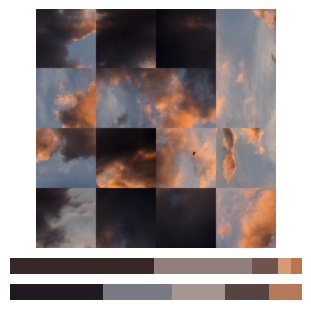

In [78]:
fig = plt.figure(figsize=(3, 3),constrained_layout=True)
gspec = fig.add_gridspec(nrows=3, ncols=1, height_ratios=[4,.3,.3])

ax0 = fig.add_subplot(gspec[0])
ax0.imshow(red_img)
ax0.axis('off')

ax1 = fig.add_subplot(gspec[1])
bar_pct(ax1,u_hextend)

ax2 = fig.add_subplot(gspec[2])
bar_pct(ax2,red_hexent)

plt.show();

Parmi les différences entre les deux palettes, il y a notamment :
* le premier cluster, qui a diminué et s'est assombri
* le grand cluster gris dans la première palette semble s'être séparé entre gris plus clair et bleu sombre
* les deux couleurs minoritaires dans la première palette sont finalement fusionnées dans la seconde

Cette comparaison montre une meilleure diversité de couleurs en partant d'un KMeans sur l'ensemble de l'image réduite. Pour rappel, voici ce que proposait le service Google :

![g_palette](img/g_palette.png "Title")

Allons vite sur le clou du spectacle : la fameuse Devil Palette. Celle-ci va s'articulier comme des puzzles à une, deux et trois dimensions. 

Nous allons préparer une fonction qui va opacifier à l'intérieur de l'image tous les pixels qui ne font pas partie d'un cluster. La logique est la suivante :
* nous partons de la DF avec les labels de cluster. Une syntaxe telle que DF\["cluster"\]==i va renvoyer une liste de booléens, **autrement dit... un vecteur**
* **dans la syntaxe de Python, le symbole ~ inverse une proposition**. Nous pouvons sélectionner tous les pixels appartenant à un cluster, et simplement inverser cette sélection en la précédent d'une tilde afin de sélectionner les pixels qui ne font pas partie de ce cluster
* nous reformatons ensuite l'image (traduite en tableau Numpy) pour que rien ne dépasse
* **nous appliquons ce masque à l'ensemble de l'image** : si le pixel ne fait pas partie du cluster, son opacité est réduite à 0

In [215]:
def clus_opa(img:Image, DF:pd.core.frame.DataFrame, index_cluster:int):
    """
        Cette fonction compare une image avec une DF de ses pixels divisés en clusters.
        Pour un cluster donné, la fonction opacifie tous les pixels qui ne font pas partie de l'image
    """
    try:
        t_img = img.copy().convert("RGBA")
        arr_img = np.array(t_img, dtype=np.ubyte)
        mask = ~np.array(DF["cluster"]==index_cluster).reshape(arr_img[:,:,3].shape)
        arr_img[:,:,-1] = np.where(mask, 0, 255)
        return Image.fromarray(np.ubyte(arr_img))
    except IndexError:
        print("Attention, votre DF doit avoir le même nombre de lignes que les pixels de l'image !")

Enfin, nous allons coder une fonction qui va isoler la couleur d'un cluster bien centrée, en conservant son pourcentage :

In [216]:
def one_hexcent(axis_ref,DF:pd.core.frame.DataFrame,index_cluster:int, orientation="vertical"):
    """
      Cette fonction affiche (à l'horizontale ou à la verticale) le pourcentage d'un cluster précis, coloré et centré.
      Elle prend en argument un axe de référence sur une visualisation matplotlib, une DataFrame
    """
    try:
        match(orientation):
            case "vertical":
                row_clus = DF[DF["cluster"]==index_cluster]
                b_margin = abs((row_clus["p"]-100)/2)
                axis_ref.set_ylim(0,100)
                plt.bar(0,row_clus["p"],bottom=b_margin,color=row_clus["hex"])
                axis_ref.grid(False)
                axis_ref.axis('off')
            case "horizontal":
                row_clus = DF[DF["cluster"]==index_cluster]
                b_margin = abs((row_clus["p"]-100)/2)
                axis_ref.set_ylim(0,100)
                plt.barh(0,row_clus["p"],left=b_margin,color=row_clus["hex"])
                axis_ref.grid(False)
                axis_ref.axis('off')
            case _:
                print("L'attribut orientation ne prévoit que deux cas de figure. Merci de choisir entre horizontal et vertical.")
    except TypeError:
        print("Attention au format des variables.")
    except IndexError:
        print("Attention : votre DataFrame doit bien contenir une colonne 'cluster'")

Rendons la chose plus concrète en affichant une pièce de chaque puzzle :
* le premier, d'une dimension, concerne la palette abstraite
* le deuxième, de trois dimensions, concerne le nuage de points sur les axes RVB
* le troisième, de deux dimensions, concerne les pixels de l'image rangés dans le cluster considéré

Ce qui donne, par exemple, pour le troisième cluster :

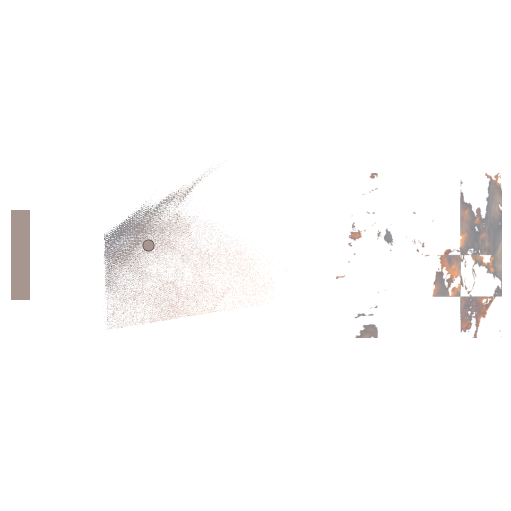

In [81]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)
gspec = fig.add_gridspec(nrows=1, ncols=3, width_ratios=[.5,7,4])

ax0 = fig.add_subplot(gspec[0])
one_hexcent(ax0,red_hexent,2)

ax1 = fig.add_subplot(gspec[1],projection='3d')
D3_clusters(ax1,red_col[red_col["cluster"]==2], DF_ruclus[DF_ruclus["cluster"]==2],r_data=.2,r_cluster=65)
ax1.axis('off')

ax2 = fig.add_subplot(gspec[2])
ax2.imshow(clus_opa(red_img,red_col,2))
ax2.axis('off')

plt.show()

Le nuage de points, où la frontière se dispute entre de nombreux gris et des roses épars, se complète bien avec les pixels de l'image, nous conserverons donc cet ordre d'apparition. Tout est désormais prêt pour afficher un poster sur l'ensemble des clusters. Il sera composé :
* d'un rappel de l'image
* d'une ligne de trois visualisations par cluster (barre proportionnelle de la couleur, nuage de points 3D, pixels concernés dans l'image)

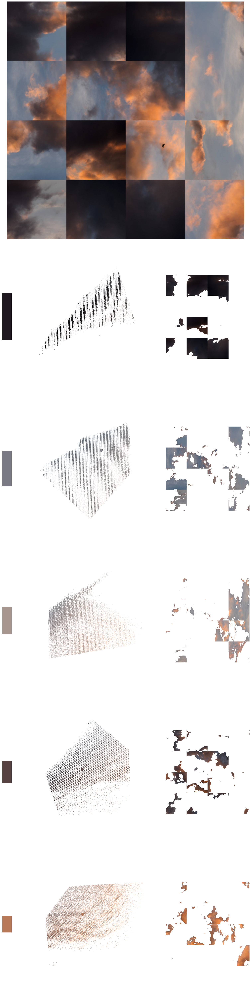

In [82]:
fig = plt.figure(figsize=(15,60),constrained_layout=True)
gspec = fig.add_gridspec(nrows=6, ncols=3, height_ratios=[8,5,5,5,5,5],width_ratios=[.5,7,4])

ax0 = fig.add_subplot(gspec[0,:])
ax0.imshow(red_img)
ax0.axis('off')

for i in range(5):
  id_clus = red_hexent.iloc[i]["cluster"]

  ax_b = fig.add_subplot(gspec[i+1,0])
  one_hexcent(ax_b,red_hexent,id_clus)    

  ax_p = fig.add_subplot(gspec[i+1,1],projection='3d')
  D3_clusters(ax_p,red_col[red_col["cluster"]==id_clus], DF_ruclus[DF_ruclus["cluster"]==id_clus])
  ax_p.axis('off')

  ax_i = fig.add_subplot(gspec[i+1,2])
  ax_i.imshow(clus_opa(red_img,red_col,id_clus))
  ax_i.axis('off')

plt.show()

# Dernières factorisations avant déploiement

Nous avons beaucoup insisté sur la factorisation de tout ce qui a été fait. Cela va nous permettre de livrer un module de deux visualisations aux petits oignons. 

La principale étape avant d'y arriver est d'avoir trois DataFrames :
* une qui répertorie tous les pixels avec canaux RVB, traduction hexadécimales et clusters
* une qui répertorie les clusters avec indices, canaux RVB et couleurs hexadécimales
* une de pourcentages de ces différents clusters

Afin que tout soit parfaitement d'équerre, l'image doit être la plus optimisée possible. Nous allons préparer une fonction qui va : 
* la recadre par défaut avec une largeur de 512 pixels
* affiche des messages d'avertissement si la largeur de l'image franchit certaines limites

Cette fonction renverra une DataFrame ainsi que l'image en question. Démonstration :

In [217]:
def prep_picture(path:str, width=512):
    """
        Cette fonction prépare une image en vue d'un retraitement par intelligence artificielle.
        Elle ne prend que deux arguments : un chemin (local ou URL) et une largeur
    
    """
    try:
        img = pic_newd(rgb_convert(path),width)
        if max(img.size)<256:
            print("Attention, l'image est peut-être de trop basse résolution pour donner des palettes pertinents")
        elif min(img.size)>1024:
            print("L'image est d'assez haute résolution. Nous conseillons de la réduire afin d'obtenir une palette plus pertinente.")
        DF = col_neslist(pd.DataFrame(columns=["r","v","b","hex"]),pic_matrix(img),["r","v","b"])
        DF["hex"] = hex_convert(pic_matrix(img))
        return DF, img
    except TypeError:
        print("Veuillez vérifier le format de vos variables")

Et vérification, avec d'abord la DF :

In [220]:
test, img = prep_picture("https://live.staticflickr.com/65535/52415681975_e72a706a2f_k.jpg")
test

,r,v,b,hex
0,36,31,37,#241F25
1,36,31,37,#241F25
2,36,31,37,#241F25
3,37,32,38,#252026
4,37,32,38,#252026
...,...,...,...,...
262139,142,120,123,#8E787B
262140,135,117,120,#877578
262141,137,120,123,#89787B
262142,133,118,124,#85767C


Puis l'image

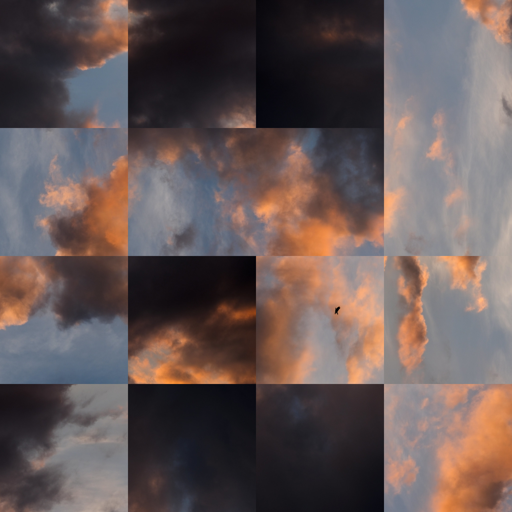

In [221]:
img

Une fois cette BDD de données prête, nous pouvons passer à l'étape K-Means. Quelques précautions vont être prises :
* le calcul du nombre de cluster via Yellowbrick devra être défini par l'utilisateur **en changeant un booléen**
* **le nombre de clusters par défaut est 5**
* si l'utilisateur ne renseigne pas un nombre de classes compris entre 2 et 10, cinq classes lui seront imposées

Cette fonction renverra chacune des trois DataFrames énumérées avant.

In [204]:
def prep_cluster(DF:pd.core.frame.DataFrame, n_clus=5, deter=False):
    """
        Cette fonction prépare trois DataFrames à partir d'un tableau Numpy généré par la fonction prep_picture.
        Elle va, en fonction d'un nombre de classes (entre 2 et 10), déterminer les groupes de couleurs les plus cohérents.
        On peut aussi laisser le programme déterminer le nombre de clusters optimal en changeant la variable deter. 
    """
    try:
        X = DF[["r","v","b"]]
        if deter:
            n_clus = nclusters_kmeans(X)
        elif ~n_clus in list(range(2,11)):
            n_clus = 5
            print("Vous devez choisir pour n_clus un nombre compris entre 2 et 10. Le nombre imposé sera 5.")
        modele = KMeans(n_clusters=n_clus,n_init=10).fit(X)
        DF_clusters = clusters_to_df(modele)
        DF = labels_kmeans(DF,modele)
        DF_hexcent = hexcent_clus(DF_clusters,DF)
        return DF, DF_clusters ,DF_hexcent
    except TypeError:
        print("Veuillez vérifier le format de vos variables")

Démo illico :

In [223]:
t_DF, t_clus, t_hexcent = prep_cluster(test)
t_hexcent

,hex,cluster,p
0,#1F1B1F,0,32.19
4,#797A83,4,23.54
1,#A69590,1,18.13
2,#594542,2,14.81
3,#B97958,3,11.33


Afin de rendre la palette calculée exploitable d'une autre manière, nous allons prévoir une **petite fonction qui va enregistrer dans un fichier txt l'ensemble des valeurs d'une colonnes**, toutes séparées par des slash. Par défaut, elle considérera la colonne *hex* :

In [202]:
def col_to_text(DF:pd.core.frame.DataFrame,n_col="hex",path_file="palette.txt"):
    """
        Cette fonction transforme la colonne d'une DataFrame en chaîne de caractères glissée dans un fichier txt.
    
    """
    try:
        with open(path_file,"w") as f:
            f.write(r' / '.join(DF[n_col]))
        f.close()
    except IndexError:
        print("Merci de considérer une DataFrame contenant la colonne mise en argument")

Ce détour effectué, nous allons coder la première fonction de visualisation de palette *simple* (image+palette proportionnelle). Deux nouvelles variables par défaut vont être paramétrées, l'une pour le nom de fichier de la palette en jpg, l'autre pour le résumé en fichier txt :

In [201]:
def simple_palette(img_path:str,w=512,nb_clus=5, auto_cluster=False,path_palette="palette.jpg", path_text="palette.txt"):
    """
       Cette fonction crée une palette simple à partir d'une image locale ou hébergée sur Internet.
       Le nombre de couleurs de la palette (entre 2 et 10) est renseigné par l'utilisateur ou calculé par K-Means. 
       Il suffit de changer auto_cluster par True.
       Chaque palette est accompagnée du détail de ses couleurs dans un fichier texte.
    
    """
    try:
        DF, img_ref = prep_picture(img_path,width=w)
        hex_DF = prep_cluster(DF, n_clus=nb_clus,deter=auto_cluster)[2]
        
        fig = plt.figure(figsize=(15,15),constrained_layout=True)
        gspec = fig.add_gridspec(nrows=2, ncols=1, height_ratios=[4,.3], hspace=.1)

        ax0 = fig.add_subplot(gspec[0])
        ax0.imshow(img_ref)
        ax0.axis('off')
        ax1 = fig.add_subplot(gspec[1])
        bar_pct(ax1,hex_DF)
    
        col_to_text(hex_DF,path_file=path_text)
        plt.savefig(path_palette,dpi=300, bbox_inches="tight", pad_inches=1)
    except TypeError:
        print("Attention à vos chemins de fichier.")

Nous pouvons dès lors tester cette affaire sur la première image :

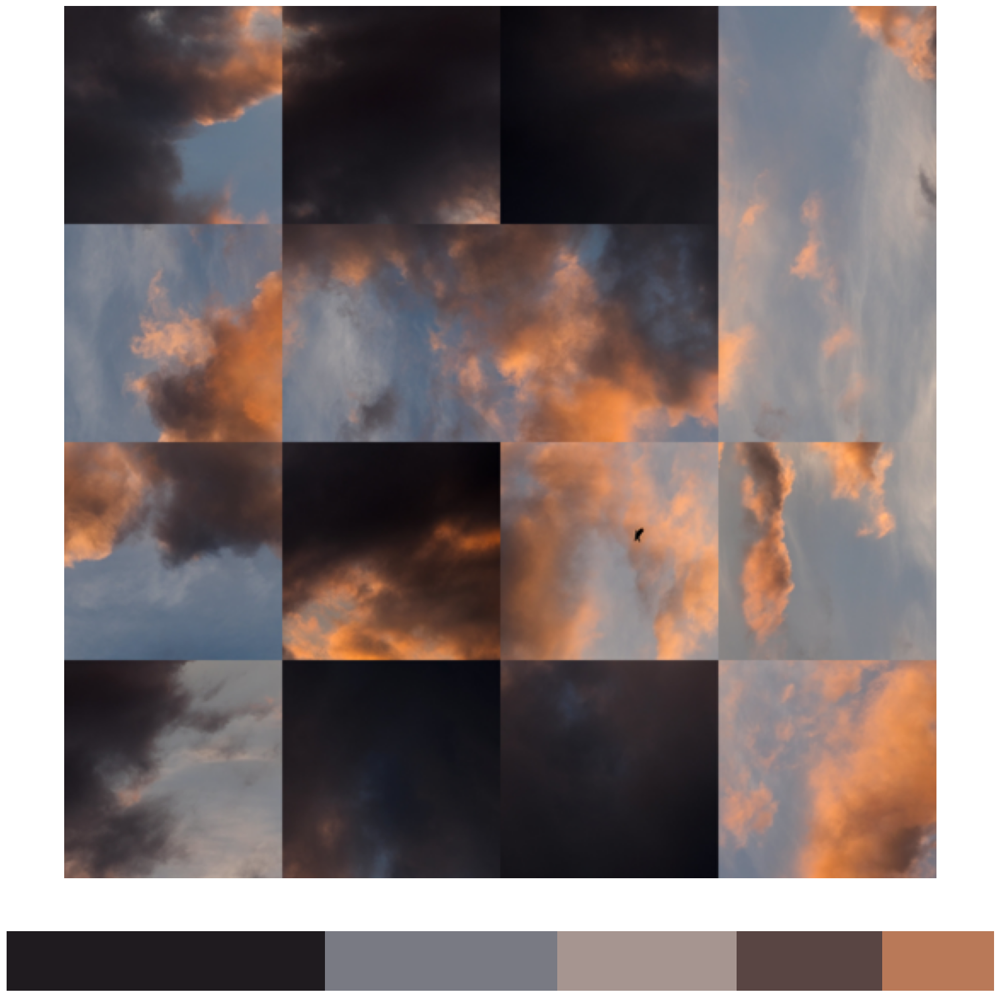

In [224]:
simple_palette("https://live.staticflickr.com/65535/52415681975_e72a706a2f_k.jpg",path_palette="img/palette.jpg",path_text="img/palette.txt")

Et maintenant, le plus gros morceau avec la palette à la diable (les Alsaciens savent), ou *Devil Palette*. Cette dernière va reprendre les grandes lignes du poster codée en dur précédemment :

In [212]:
def devil_palette(img_path:str,w=512,nb_clus=5, auto_cluster=False,path_palette="devil_palette.jpg", path_text="palette.txt"):
    """
        Cette fonction crée une 'palette à la diable' à partir d'une image.
        Elle se compose d'un rappel de l'image et d'une ligne par classe de couleur identifiée.
        A chaque ligne, nous avons :
            le rappel de la couleur, avec longueur proportionnelle à sa présence dans l'image
            la composition du cluster en nuage de points 3D sur un axe RVB
            les pixels présents dans le cluster directement dans l'image
        Le programme peut aussi déterminer lui-même le nombre de clusters (entre 1 et 10) si passe la variable auto_cluster à True    
    """
    try:
        DF, img_ref = prep_picture(img_path,width=w)
        def_DF, clus_DF, hex_DF = prep_cluster(DF, n_clus=nb_clus,deter=auto_cluster)

        fig = plt.figure(figsize=(15,10+(len(clus_DF)*10)),constrained_layout=True)
        gspec = fig.add_gridspec(nrows=1+len(clus_DF), ncols=3, height_ratios=[8]+[5]*len(clus_DF),width_ratios=[.5,7,4])

        ax0 = fig.add_subplot(gspec[0,:])
        ax0.imshow(img_ref)
        ax0.axis('off')

        for i in range(len(clus_DF)):
            id_clus = hex_DF.iloc[i]["cluster"]

            ax_b = fig.add_subplot(gspec[i+1,0])
            one_hexcent(ax_b,hex_DF,id_clus)    

            ax_p = fig.add_subplot(gspec[i+1,1],projection='3d')
            D3_clusters(ax_p,def_DF[def_DF["cluster"]==id_clus], clus_DF[clus_DF["cluster"]==id_clus])
            ax_p.axis('off')

            ax_i = fig.add_subplot(gspec[i+1,2])
            ax_i.imshow(clus_opa(img_ref,def_DF,id_clus))
            ax_i.axis('off')
        
        col_to_text(hex_DF,path_file=path_text)
        plt.savefig(path_palette,dpi=300, bbox_inches="tight", pad_inches=1)
    except TypeError:
        print("Attention à vos chemins de fichier.")

Et un ultime test en laissant le programme proposer son nombre de clusters :

Ca va prendre moins d'une minute, mais buvez du café !


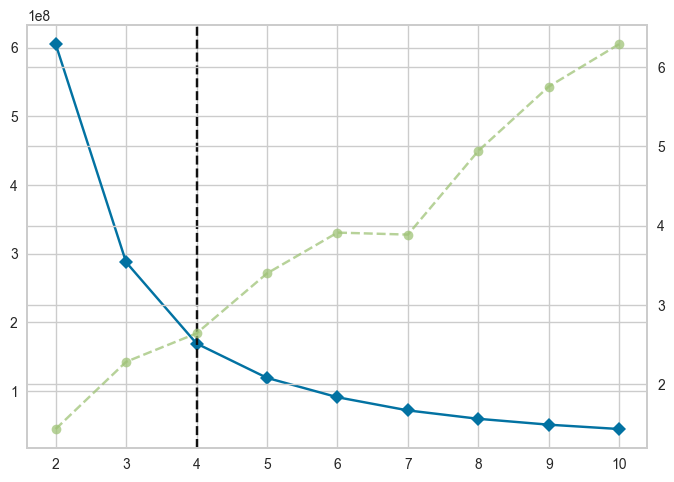

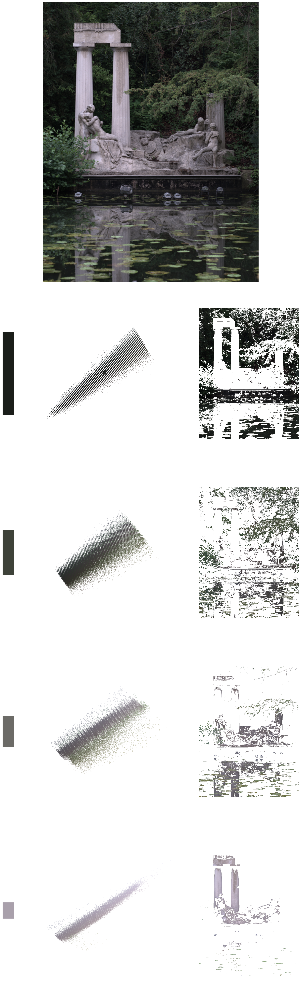

In [213]:
devil_palette("https://live.staticflickr.com/65535/53133046832_983b416b92_3k.jpg",auto_cluster=True,path_palette="img/devil_palette.jpg",path_text="img/devil_palette.txt")

Evidemment, les résultats peuvent beaucoup varier selon le nombre de clusters et les dimensions de l'image retenues. Sentez-vous libres de le tester et de l'adapter à votre sauce !

# [Lien vers le module](https://github.com/raphadasilva/devil_palette)

# Bibliographie

* Mike X Cohen, *Practical Linear Algebra for Data Science*, Sebastopol (California), O'Reilly, 2022
* Martin Helm, *[A deep dive into k-means](https://towardsdatascience.com/a-deep-dive-into-k-means-f9a1ef2490f8)*, Medium, Towards Data Science, consulté le 24 décembre 2022
* Indraneel Dutta Baruah, *[Cheat sheet for implementing 7 methods for selecting the optimal number of clusters in Python](https://towardsdatascience.com/cheat-sheet-to-implementing-7-methods-for-selecting-optimal-number-of-clusters-in-python-898241e1d6ad)*, Medium, Towards Data Science, consulté le 24 décembre 2022
* Satoru Hayasaka, *[How Many Clusters?](https://towardsdatascience.com/how-many-clusters-6b3f220f0ef5)*, Medium, Towards Data Science, consulté le 24 décembre 2022
* Tim Löhr, *[K-Means Clustering and the Gap-Statistics](https://towardsdatascience.com/k-means-clustering-and-the-gap-statistics-4c5d414acd29)*, Medium, Towards Data Science, consulté le 24 décembre 2022